**Prediction using GANs For Fluid Problem** 

This notebook contains the workflow, development code and some results of the PredGAN for 2D turbulent fluid modelling completed as an independent research component of the M.Sc. degree in [Applied Computational Science and Engineering](https://www.imperial.ac.uk/earth-science/prosp-students/pg-courses/applied-computational-msc/) at Royal School of Mines at Imperial College London (ICL).

The project was part of the Applied Modelling and Computational Group @ ICL and was supervised by :
- Prof Christopher Pain
- Dr. Claire E. Heaney
- Vinicius Santos Silva 

This notebook is divided in sections that included data preprocessing tasks, core code body and results visualization. Part of this project is the data assimilation of sensor data. For more information about this and the rest of the work, here is a link to the report completed alongside this code devlopment. More details can also be found in the [github repository](https://github.com/acse-moj20/msc-irp)



Contact: Mustapha Jolaade, moj20@ic.ac.uk

September 02, 2021





*Required environment and packages*

In [ ]:
%matplotlib inline
import sys
import os
import sklearn
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import joblib
import time
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Plot formatting 
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


# Processing and memory details

In [ ]:
# ******** GPU Specifications *************
# *****************************************

gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('GPU info not found.')
else:
  print(gpu_info)
print('Num of available GPUs: ', len(tf.config.list_physical_devices('GPU')))

# ******** Allocated memmory *************
# ****************************************
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print()
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('You are using a high-RAM runtime!')

Fri Sep  3 06:31:38 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.63.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   46C    P0    30W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

#Utility Functions

Functions used for auxiliary tasks like error calculation, result visualization, data manipulation, etc.

In [ ]:

def calculate_error(data, prediction):
  '''
  Computes the absolute and percentage error between two arrays.
  Arrays must be of equal length.

  Parameters
  ----------
      data : ndarr
          m-by-n array of true values.
      data_recovered : ndarr
          m-by-n array of predicted values.

  Returns
  -------
      max_abs_error (float)
          max absolute error between data and prediction.
      mean_abs_error (float)
          mean absolute error between data and prediction.
  '''
  assert(len(data)==len(prediction))
  abs_error = abs(data - prediction)
  perc_error = abs_error*100/abs(data)
  max_abs_error = np.max(abs_error)
  mean_abs_error = np.mean(abs_error)
  return max_abs_error, mean_abs_error


def plot_vortex(data, times, cols, rows=1, skips=1, c_bar=True, cmap='RdBu'):
  '''
  Visualization .

  Parameters
  ----------
      data : ndarr
          m-by-n array of true values.
      data_recovered : ndarr
          m-by-n array of predicted values.

  Returns
  -------
      max_abs_error (float)
          max absolute error between data and prediction.
      mean_abs_error (float)
          mean absolute error between data and prediction.
  '''
  fig, ax = plt.subplots(rows, cols, figsize=[5* cols, 20])
  for i, step in enumerate(times):
    im = ax.flatten()[i].imshow(data[step], cmap=cmap)
    if c_bar:
      cbar = plt.colorbar(im, ax=ax.flatten()[i], shrink=0.15, pad=0.05, panchor=(0.0, 0.0))
    ax.flatten()[i].set_title('t = {}'.format(step*skips), y=1.05, 
                          fontsize=16, fontweight="bold")
   
  plt.show()



def plot_linevortex(data_dict, times, cols, rows=1, skips=1):
  '''
  Computes the absolute and percentage error between two arrays.
  Arrays must be of equal length.

  Parameters
  ----------
      data : ndarr
          m-by-n array of true values.
      data_recovered : ndarr
          m-by-n array of predicted values.

  Returns
  -------
      max_abs_error (float)
          max absolute error between data and prediction.
      mean_abs_error (float)
          mean absolute error between data and prediction.
  '''
  # use a gray background
  fig, ax = plt.subplots(rows, cols, figsize=[5* cols, 9], sharey='all')
  
  for i, step in enumerate(times):
    #im = ax.flatten()[i].imshow(data[step], cmap=cmap)
    for label in data_dict:
      plot_data = data_dict[label]
      plot_data_1d = plot_data[step].reshape(-1, 1)
      line_plt = ax.flatten()[i].plot(plot_data_1d, label=label)
      
      # Plot max and min locations
      ax.flatten()[i].plot(np.where(plot_data_1d == np.amax(plot_data_1d))[0], 
               np.amax(plot_data_1d), "bo", label='Pos. vortex')
      ax.flatten()[i].plot(np.where(plot_data_1d == np.amin(plot_data_1d))[0], 
               np.amin(plot_data_1d), "ro", label='Neg. vortex')

    if i == 0:
      ax.flatten()[i].legend(loc='best', prop={'size':10})
      ax.flatten()[i].set_ylabel('Magnitude of vortices')
    ax.flatten()[i].set_title('t = {}'.format(step*skips), y=1.05, 
                          fontsize=16, fontweight="bold")
    fig.text(0.5, -0.04, '1D Spatial domain', fontdict={
        'weight': 'normal',
        'size': 14,}, ha='center')
    
    
  plt.show()

def concat_timesteps(X_train, ntimes, step, window_start, window_end, verbose=0):
  '''
  Computes the absolute and percentage error between two arrays.
  Arrays must be of equal length.

  Parameters
  ----------
      data : ndarr
          m-by-n array of true values.
      data_recovered : ndarr
          m-by-n array of predicted values.

  Returns
  -------
      max_abs_error (float)
          max absolute error between data and prediction.
      mean_abs_error (float)
          mean absolute error between data and prediction.
  '''
  X_train_concat = []
  for start, end in zip(window_start, window_end):
    for i in range(start, end+step): 
      X_train_concat.append(X_train[i:i+ntimes*step:step])
      if verbose:
        print('sample starts from {} :'.format(i))
        for j in range(i, i+ntimes*step, step):
          print('{}'.format(j) , end=', ')
        print('\n')
  return np.array(X_train_concat)

def invert_data(X_data, flag=None):
  '''
  Computes the absolute and percentage error between two arrays.
  Arrays must be of equal length.

  Parameters
  ----------
      data : ndarr
          m-by-n array of true values.
      data_recovered : ndarr
          m-by-n array of predicted values.

  Returns
  -------
      max_abs_error (float)
          max absolute error between data and prediction.
      mean_abs_error (float)
          mean absolute error between data and prediction.
  '''
  if flag=='3':
    X_scale_inverted = scaler3.inverse_transform(X_data)
    X_pca_inverted = pca3.inverse_transform(X_scale_inverted)
  else:
    X_scale_inverted = scaler.inverse_transform(X_data)
    X_pca_inverted = pca.inverse_transform(X_scale_inverted)
  return X_pca_inverted

def transform_data(X_data):
  '''
  Computes the absolute and percentage error between two arrays.
  Arrays must be of equal length.

  Parameters
  ----------
      data : ndarr
          m-by-n array of true values.
      data_recovered : ndarr
          m-by-n array of predicted values.

  Returns
  -------
      max_abs_error (float)
          max absolute error between data and prediction.
      mean_abs_error (float)
          mean absolute error between data and prediction.
  '''
  X_pca = pca.fit_transform(X_data)
  X_pca_scaled = scaler.fit_transform(X_pca)
  return X_pca_scaled


#**POD Based Non-Intrusive Reduced Order Modelling**

##Data Details

*   Raw dataset represents the parameter values of u, v and p for 1200 separate examples of the high fidelity solution.
*   Each example is computed over 50 timesteps and a on a 256-by-256 grid.

*   Vorticity over the vector field is obatined by computing the curl of u (x-component velocity vector) and v (y-component velocity vector)


**Note:** Due to memory constraints, only implementation of a fraction of the dataset (100 trajectories - 7GB) is shown here. The workflow does not chnage for a much larger dataset.






In [ ]:
# Load x and y velocity components 
data_dir = 'drive/MyDrive/MSC_IRP/data/vortex_100.npy'
data_file = np.load(data_dir)

# Print data details
print('Size of dataset:         ', data_file.shape)
print('Number of data samples:  ', len(data_file))
print('Size of each sample:     ', data_file[0].shape)
print('Number of time steps:    ', len(data_file[0]))

Size of dataset:          (100, 50, 256, 256, 3)
Number of data samples:   100
Size of each sample:      (50, 256, 256, 3)
Number of time steps:     50


In [ ]:

# *** Computing vorticity from vector field ***
# *********************************************

def curl(u,v):
  """ 
  Function to calculate the curl of a 2-dimensional vector field.
  Parameters:
  -----------
    u : 2d array of size n*m
      vector component in the x direction.

    v : 2d array of size n*m
      vector component in the y direction
  Output:
  -------
    curl : 2d array of size n*m
      curl of vector field [i.e. (dv/dx)i - (du/dy)j]
  """
  curl = np.gradient(v)[0] - np.gradient(u)[1]
  return curl

def process(data, save=False):
  """ 
  Function to calculate the curl of a 2-dimensional vector field.
  Parameters:
  -----------
    u : 2d array of size n*m
      vector component in the x direction.

    v : 2d array of size n*m
      vector component in the y direction
  Output:
  -------
    curl : 2d array of size n*m
      curl of vector field [i.e. (dv/dx)i - (du/dy)j]
  """
  assert(len(data)>0)
  assert(len(data.shape) > 3)
  size = len(data)

  vorticity = np.zeros_like(data[:,:,:,:,0])
  # placehodler for vorticity 
  start = time.time()
  for i in range(len(data_file)):
    for j in range(len(data_file[0])):
      vorticity[i][j] = curl(data_file[i][j][:, :, 0], data_file[i][j][:, :, 1])
  if save:
    save_dir = 'drive/MyDrive/MSC_IRP/data/calc_vortex_' + str(len(data))+'.npy'
    np.save(save_dir, vorticity)
    print(' Processed data saved at: ' + save_dir)
  print('--------- Done in {:.5f}s. -------- '.format( time.time()-start))
  return vorticity

In [ ]:
trajs = process(data_file)

--------- Done in 10.43701s. -------- 


##Dataset visualization

In [ ]:
trajs.shape

(100, 50, 256, 256)

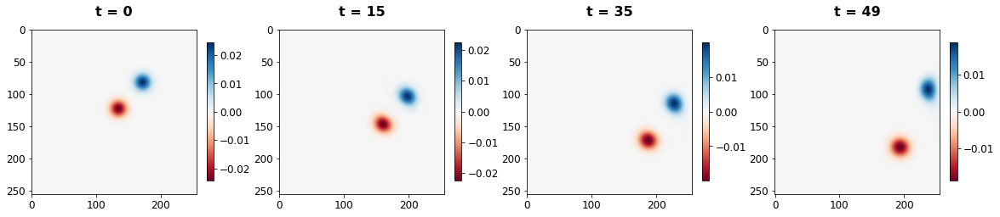

In [ ]:
# We want to visualize the trajectory at times: 0, 15, 35 and 49
idx = 0
times = [0, 15, 35, 49]
plot_vortex(trajs[idx], times, cols=4, rows=1)


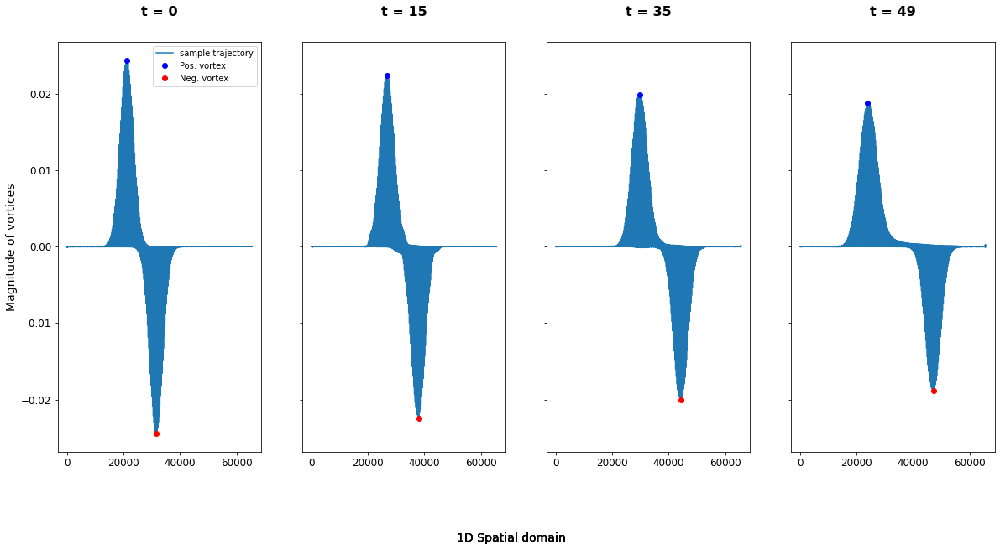

In [ ]:
# We want to visualize the trajectory projected on a linear domain to observe vortices magnitude
plot_linevortex({'sample trajectory': trajs[idx]}, times, cols=4, rows=1)

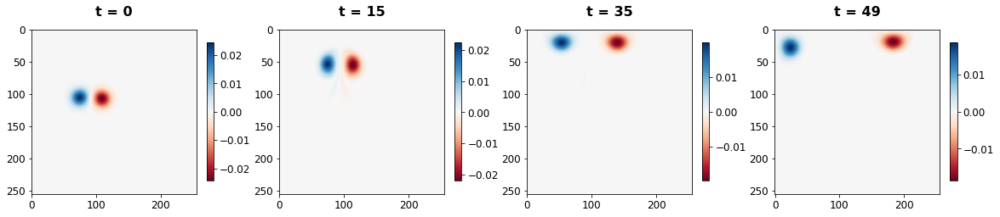

In [ ]:
plot_vortex(trajs[69], times, cols=4, rows=1)

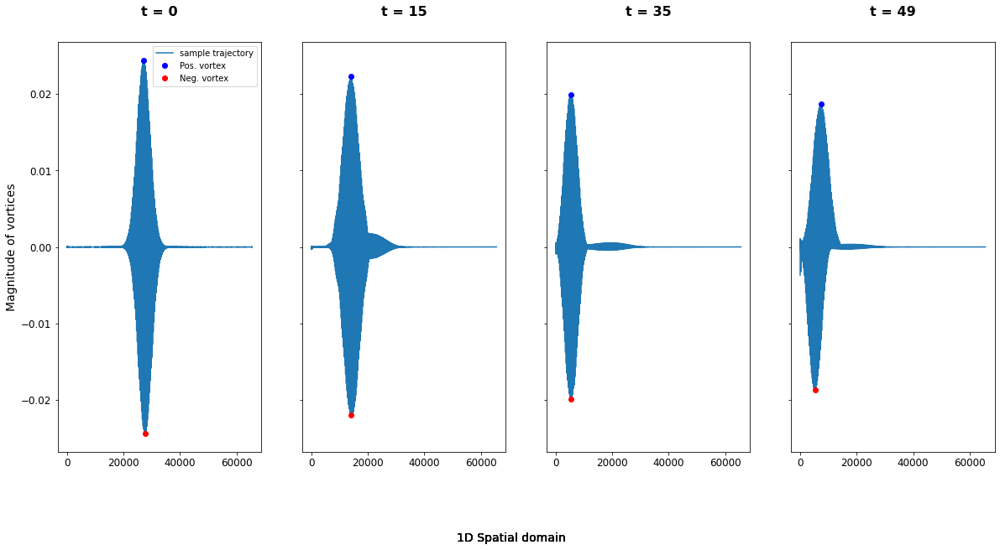

In [ ]:
plot_linevortex({'sample trajectory': trajs[69]}, times, cols=4, rows=1)

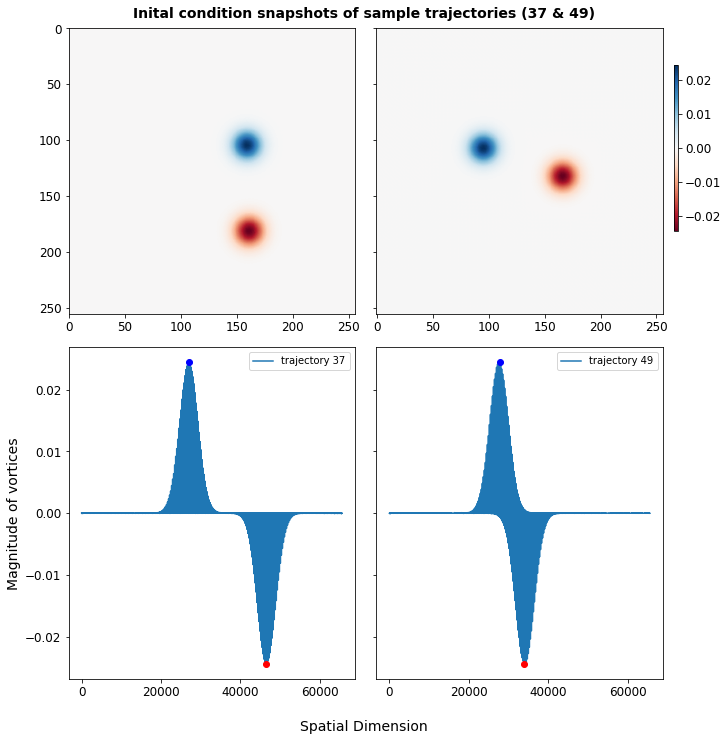

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:34: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:34: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 


In [ ]:
# Reverse transform concatenated series to check correctness
fig, ax = plt.subplots(2, 2, figsize=[10,10], sharex='row', sharey='row', constrained_layout=True)
im = ax.flatten()[0].imshow(trajs[37][0], cmap='RdBu')
im = ax.flatten()[1].imshow(trajs[49][0], cmap='RdBu')

ax.flatten()[2].plot(trajs[37][0].reshape(-1, 1), label='trajectory 37')
ax.flatten()[2].legend()

# Plot max and min locations
ax.flatten()[2].plot(np.where(trajs[37][0].reshape(-1, 1) == np.amax(trajs[37][0].reshape(-1, 1)))[0], 
          np.amax(trajs[37][0].reshape(-1, 1)), "bo", label='Pos. vortex')
ax.flatten()[2].plot(np.where(trajs[37][0].reshape(-1, 1) == np.amin(trajs[37][0].reshape(-1, 1)))[0], 
          np.amin(trajs[37][0].reshape(-1, 1)), "ro", label='Neg. vortex')

ax.flatten()[3].plot(trajs[49][0].reshape(-1, 1), label='trajectory 49')
ax.flatten()[3].legend()
ax.flatten()[3].plot(np.where(trajs[49][0].reshape(-1, 1) == np.amax(trajs[49][0].reshape(-1, 1)))[0], 
          np.amax(trajs[49][0].reshape(-1, 1)), "bo", label='Pos. vortex')
ax.flatten()[3].plot(np.where(trajs[49][0].reshape(-1, 1) == np.amin(trajs[49][0].reshape(-1, 1)))[0], 
          np.amin(trajs[49][0].reshape(-1, 1)), "ro", label='Neg. vortex')

fig.text(0.5, -0.04, 'Spatial Dimension', fontdict={
        'weight': 'normal',
        'size': 14,
        }, ha='center')
fig.text(0.5, 0.95,  'Inital condition snapshots of sample trajectories (37 & 49)', fontdict={
        'weight': 'bold',
        'size': 14,
        }, ha='center')
ax[1, 0].set_ylabel('Magnitude of vortices')
fig.colorbar(im, ax=ax[0,:].flatten(), shrink=0.5, pad=0.00, panchor=(0.0, 0.0))
plt.show()

fig.tight_layout()

##Dimensionality reduction - POD/PCA

The training dataset consists of samples of a high-fidelity numerical simulation each with 50 evenly sampled snapshots (in time). Each simulation represents velocity (in x and y directions) and pressure for the turbulent flow model over a region of grid size 256x256. These values can be used to generate a vorticity field for the model. Thus, there is a total number of 256 * 256 = 65,536 variables per time step and a total of 50 * 100 = 5,000 samples. Dimensionality reduction of this high dimensional space is then performed using Principal Component Analysis (PCA) in order to work with a relatively low dimension space. The PCA model uses 292 expansion coefficients that gave > 99.9% variance in the reduction.

In [ ]:
trajs.shape

(100, 50, 256, 256)

###Build PCA Model

First we find the appropriate number of POD expansion coefficients given the requirement to retain 99.99% of information/relative cumulative energy, p. 
Below we show that 292 modes is appropriate to fulfill the criteria. 

The model reduction is then carried out using the number of modes. 

In [ ]:
nx = trajs.shape[-2]  # snapshot x dim
ny = trajs.shape[-1]  # snapshot y dim
trajs_1d = trajs.reshape((-1, nx*ny))
print(trajs_1d.shape)

# Initiate PCA
pca = PCA(trajs_1d.shape[0])
trajs_pca = pca.fit_transform(trajs_1d)

(5000, 65536)


In [ ]:
X_recovered_1d = pca.inverse_transform(X_train_pca)
np.allclose(X_recovered_1d, X_train1d)

True

In [ ]:
p = 0.999
cumsum_eig = np.cumsum(pca.explained_variance_ratio_)
n_components_eig = np.argmax(cumsum_eig >= p) + 1 # returns the indices of the maximum values along an axis.
n_components_eig

292

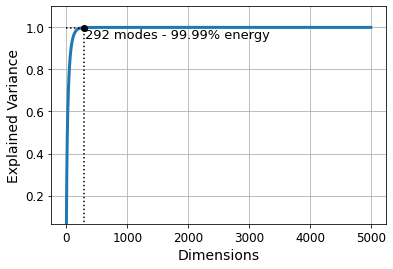

In [ ]:
plt.figure(figsize=(6,4))
plt.plot(cumsum_eig, linewidth=3)
plt.xlabel("Dimensions")
plt.ylabel("Explained Variance")
plt.ylim([cumsum_eig[0],1.1])
plt.plot([n_components_eig, n_components_eig], [0, p], "k:")
plt.plot([0, n_components_eig], [p, p], "k:")
plt.plot(n_components_eig, p, "ko")
plt.annotate("292 modes - 99.99% energy", xy=(n_components_eig, p), xytext=(n_components_eig+10, p-0.05), fontsize=13)
plt.grid(True)
plt.show()

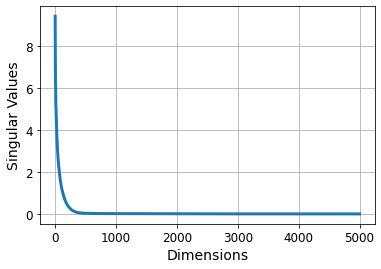

In [ ]:
sv = pca.singular_values_
plt.figure(figsize=(6,4))
plt.plot(sv, linewidth=3)
plt.xlabel("Dimensions")
plt.ylabel("Singular Values")
plt.grid(True)
plt.show()

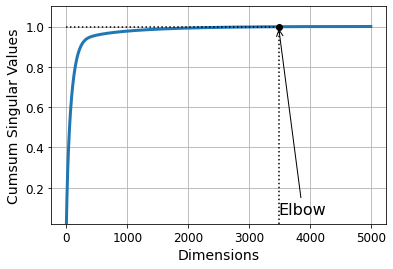

3484


In [ ]:
p = 0.999
cumsum_sv = np.cumsum(pca.singular_values_/sum(pca.singular_values_))
n_components_sv = np.argmax(cumsum_sv >= p) + 1

d = n_components_sv
plt.figure(figsize=(6,4))
plt.plot(cumsum_sv, linewidth=3)
plt.xlabel("Dimensions")
plt.ylabel("Cumsum Singular Values")
plt.ylim([cumsum_sv[0],1.1])
plt.plot([d, d], [0, p], "k:")
plt.plot([0, d], [p, p], "k:")
plt.plot(d, p, "ko")
plt.annotate("Elbow", xy=(d, p), xytext=(d, cumsum_sv[0]+0.05),
             arrowprops=dict(arrowstyle="->"), fontsize=16)
plt.grid(True)
plt.show()
print(d)

**Re-compression using 292 components)**

In [ ]:
pca_rom = PCA(n_components=n_components_eig)
trajs_pca = pca_rom.fit_transform(trajs_1d)
trajs_reconstruct = pca_rom.inverse_transform(trajs_pca)
print(trajs_pca.shape)
np.allclose(trajs_reconstruct, trajs_train1d)

(5000, 292)


False

In [ ]:
# Comparing actual data and pca reduced data
actual_data = X_train1d.reshape((-1, timestep, nx, nx))[89]
recon_data = X_reconstruct.reshape((-1, timestep, nx, nx))[89]
plot_vortex(actual_data, times, len(times))

In [ ]:
plot_vortex(recon_data, times, len(times))

In [ ]:
# Calculate error 

max_abs_err, mean_abs_err = calculate_error(actual_data, recon_data)
print("Max. abs. error: {}". format(max_abs_err))
print("Mean abs. error: {}".format(mean_abs_err))

Max. abs. error: 0.0026068006677143927
Mean abs. error: 5.0103895884519914e-05


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: divide by zero encountered in true_divide
  """


In [ ]:
# Save compression
import joblib
pca_file_dir = "drive/MyDrive/MSC_IRP/PredGAN/pca_rom_292.pkl"
with open(pca_file_dir, 'wb') as save_file:  
  joblib.dump(pca_rom, save_file)
np.save('drive/MyDrive/MSC_IRP/data/pca_calc_vortex_100.npy', X_train_pca)

#**Training Generative Adversarial Network**

Following reduction in dimension, we can now proceed to train a GAN/WGAN-GP for time series prediction using the POD axpansion coefficients. 

Prior to traing the GAN, we perform a time series concatenation of the 50 snapshots of a trajectory. This is necessary for timeseries prediction as the GAN needs to be learn what future state of each trajectory is. 
In contenating the snapshots, we select a suitable length of the resulting concantenation. This is also the max. length the GAN can generate/predict.
```
ntimes
```
To ensure coverage, we implement user-specified gap between consecutive time level in the concatenation so a good portion of the trajectry is learned. This variable is:
```
step
```
To concatenate, a helper function
```
concatenate_timesteps(reduced_trajs, ntimes, step, window_start, window_end)
```
is built that contenates within a window since there is limited snashots for each trajectory. The output trajectories are then used as training data. 
 

In [ ]:
# ********* Data details ***********
# **********************************
mem_load = True
SAVE_DIR = 'drive/MyDrive/MSC_IRP/PredGAN/'

# spatial domain 
nx = 256 
ny = nx

# temporal domain
timestep = 50 

num_of_coeff = 292
ntimes = 7 # Consecutive times for the GAN
step = 5 # step between times


### Load Compressed Trajectories v1200

In [ ]:
if (mem_load):
  pca = joblib.load('drive/MyDrive/MSC_IRP/data/pca_rom1200_292.pkl')
  X_1d_pca = np.load('drive/MyDrive/MSC_IRP/data/pca_calc_vortex_1200.npy')
  scaler = joblib.load('drive/MyDrive/MSC_IRP/data/scaler_1200.pkl')
  
print('Number of snapshots: {}'.format(X_1d_pca.shape[0]))
X_1d_pca_scaled = scaler.fit_transform(X_1d_pca)
# np.allclose(X_1d_pca, scaler.inverse_transform((X_1d_pca_scaled)))

Number of snapshots: 60000


### Load Compressed Trajectories v300

In [ ]:
if (mem_load):
  pca3 = joblib.load('drive/MyDrive/MSC_IRP/data/pca_rom300_292.pkl')
  X_1d_pca3= np.load('drive/MyDrive/MSC_IRP/data/pca_calc_vortex_300.npy')
  scaler3 = joblib.load('drive/MyDrive/MSC_IRP/data/scaler_300.pkl')
  
print(X_1d_pca3.shape)
X_1d_pca_scaled3 = scaler.fit_transform(X_1d_pca3)
np.allclose(X_1d_pca3, scaler.inverse_transform((X_1d_pca_scaled3)))

(15000, 292)


True

### Test dimension reduction and visualize data

(50, 256, 256)


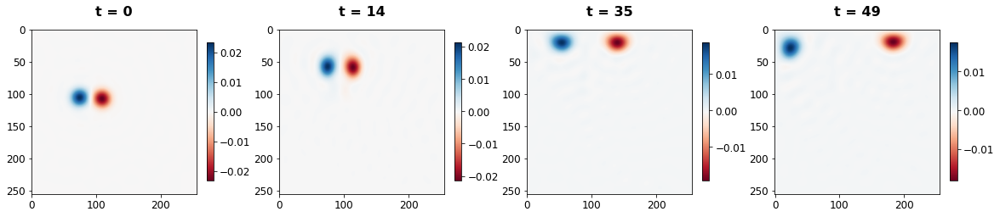

In [ ]:
# Test diemnsionality reduction
# ******************************
times = [0, 14, 35, 49]
X_recovered = invert_data(X_1d_pca_scaled[3450:3500]).reshape(timestep, nx, ny)
print(X_recovered.shape)
plot_vortex(X_recovered, times, len(times))

### Train-Test Split

In [ ]:

from sklearn.model_selection import train_test_split
X_1d_pca_scaled = X_1d_pca_scaled.reshape(-1, timestep, num_of_coeff)
X_train1d_pca_scaled, X_test1d_pca_scaled = train_test_split(X_1d_pca_scaled, test_size=0.5, random_state=1)
print('Train data: ',X_train1d_pca_scaled.shape)
print('Test data: ', X_test1d_pca_scaled.shape)
X_train1d_pca_scaled = np.reshape(X_train1d_pca_scaled, (-1, num_of_coeff))
X_test1d_pca_scaled = np.reshape(X_test1d_pca_scaled, (-1, num_of_coeff))

Train data:  (600, 50, 292)
Test data:  (600, 50, 292)


### Time series Concatenation

In [ ]:
# Time series Concantenation
sample_size = int(X_train1d_pca_scaled.shape[0]/timestep) 
window_start = [(sample*timestep)for sample in range(sample_size)]
window_end = [(sample*timestep) - (ntimes*step) for sample in range(1, sample_size + 1)]
X_train_concat = concat_timesteps(X_train1d_pca_scaled, ntimes, step, window_start, window_end)
X_train_concat_flatten = X_train_concat.reshape(X_train_concat.shape[0], (num_of_coeff )*ntimes)



print(' Number of concatenated time series for training: ', X_train_concat.shape[0])
print('---------------')
print('Test output:')
print(X_train_concat.shape)
print(X_train_concat_flatten.shape)

 Number of concatenated time series for training:  12000
---------------
Test output:
(12000, 7, 292)
(12000, 2044)


In [ ]:
# Version 300. No train test split
X_train1d_pca_scaled3 = X_1d_pca_scaled3.reshape(-1, num_of_coeff)
sample_size = int(X_train1d_pca_scaled3.shape[0]/timestep) 
window_start = [(sample*timestep)for sample in range(sample_size)]
window_end = [(sample*timestep) - (ntimes*step) for sample in range(1, sample_size + 1)]


X_train_concat3 = concat_timesteps(X_train1d_pca_scaled3, ntimes, step, window_start, window_end)
X_train_concat_flatten3 = X_train_concat3.reshape(X_train_concat3.shape[0], num_of_coeff*ntimes)
print(' Number of concatenated time series for training: ', X_train_concat3.shape[0])
print('---------------')
print('Test output:')
print(X_train_concat3.shape)
print(X_train_concat_flatten3.shape)

 Number of concatenated time series for training:  6000
---------------
Test output:
(6000, 7, 292)
(6000, 2044)


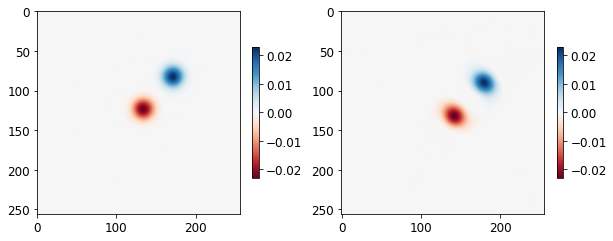

(7, 65536)


In [ ]:
# Reverse transform concatenated series to check correctness
fig, ax = plt.subplots(1, 2, figsize=[10,10])
X_ = invert_data(X_train_concat[0, :, :])
im = ax[0].imshow(X_[0,:].reshape(nx, nx), cmap='RdBu')
im = ax[1].imshow(X_[1, :].reshape(nx, nx), cmap='RdBu')
fig.colorbar(im, ax=ax.flatten()[0], shrink=0.24, pad=0.05, panchor=(0.0, 0.0))
fig.colorbar(im, ax=ax.flatten()[1], shrink=0.24, pad=0.05, panchor=(0.0, 0.0))
plt.show()
print(X_.shape)


GAN Hyperparameters

In [ ]:
g_lr = 1e-4
d_lr = 1e-4
num_examples_to_generate = 15

BATCH_SIZE = 128
latent_space = 300

generator_optimizer = tf.keras.optimizers.Adam(learning_rate=1e-4, beta_1=0.5, beta_2=0.9)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=1e-4, beta_1=0.5, beta_2=0.9)

# Seed and intitialization
seed = tf.random.normal([num_examples_to_generate, latent_space])

Dataset Creation

In [ ]:
# Create a tensorflow dataset and split it into batches
train_dataset = X_train_concat.reshape(X_train_concat.shape[0], ntimes, num_of_coeff+num_sensors, 1).astype('float32')
train_dataset = tf.data.Dataset.from_tensor_slices(train_dataset)
train_dataset = train_dataset.shuffle(len(X_train_concat)).batch(BATCH_SIZE, drop_remainder=True)

### DCGAN 

1. (original architecture with diff LR: disc=1e-4, gen=5e-5) **still collapses**
2. More latent space, 64 batch size, equal LR. **still collapses**
3. 3000 latent space, 7 consecutive times for the GAN, 5 step gap between times

Generator Model

In [ ]:
def make_generator_model():
    # model = tf.keras.Sequential()
    # model.add(keras.layers.Dense(5*73*256, use_bias=False, input_shape=(latent_space,)))
    # model.add(keras.layers.BatchNormalization())
    # model.add(keras.layers.LeakyReLU())

    # model.add(keras.layers.Reshape((5, 73, 256)))

    # model.add(keras.layers.Conv2DTranspose(128, (3, 3), strides=(1, 1), padding='same', use_bias=False))
    # model.add(keras.layers.BatchNormalization())
    # model.add(keras.layers.LeakyReLU())

    # model.add(keras.layers.Conv2DTranspose(64, (3, 3), strides=(2, 2), padding='same', use_bias=False))
    # model.add(keras.layers.BatchNormalization())
    # model.add(keras.layers.LeakyReLU())

    # model.add(keras.layers.Conv2DTranspose(1, (3, 3), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Dense(5*12*512, use_bias=False, input_shape=(latent_space,)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())

    model.add(tf.keras.layers.Reshape((5, 12, 512)))

    model.add(tf.keras.layers.Conv2DTranspose(256, (3, 7), strides=(1, 1), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU()) 

    model.add(tf.keras.layers.Conv2DTranspose(128, (3, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())

    model.add(tf.keras.layers.Conv2DTranspose(64, (3, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())

    model.add(tf.keras.layers.Conv2DTranspose(32, (3, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())

    model.add(tf.keras.layers.Conv2DTranspose(1, (3, 7), strides=(1, 3), padding ='valid', output_padding=[0,0], use_bias=False, activation='tanh'))

    return model
generator = make_generator_model()
generator.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 30720)             92160000  
_________________________________________________________________
batch_normalization (BatchNo (None, 30720)             122880    
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 30720)             0         
_________________________________________________________________
reshape (Reshape)            (None, 5, 12, 512)        0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 5, 12, 256)        2752512   
_________________________________________________________________
batch_normalization_1 (Batch (None, 5, 12, 256)        1024      
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 5, 12, 256)        0

Testing the model generator

(1, 7, 292, 1)
(7, 65536)


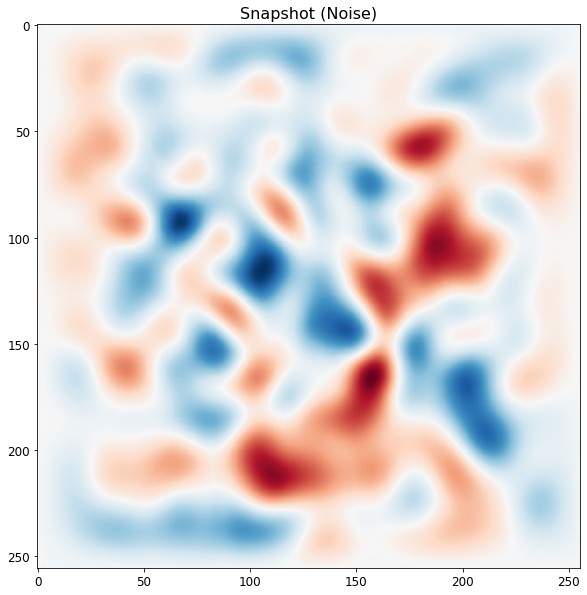

In [ ]:
noise = tf.random.normal([1, latent_space])
generated_image = generator(noise, training=False)
print(generated_image.shape)

fig, ax = plt.subplots(figsize=[10,10])
inv_generated_image = invert_data(generated_image[0, :, :, 0])
print(inv_generated_image.shape)
ax.imshow(inv_generated_image[0, :].reshape(nx, nx), cmap='RdBu');
ax.set_title('Snapshot (Noise)', fontsize=16);

Discriminator

In [ ]:
def make_discriminator_model():
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Conv2D(64, (3, 3), strides=(2, 2), padding='same',
                                     input_shape=[ntimes, num_of_coeff, 1]))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    # model.add(tf.keras.layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    # model.add(tf.keras.layers.LeakyReLU())
    # model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(256, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    # model.add(tf.keras.layers.Conv2D(256, (5, 5), strides=(2, 2), padding='same'))
    # model.add(tf.keras.layers.LeakyReLU())
    # model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(1))

    return model
discriminator = make_discriminator_model()
discriminator.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_10 (Conv2D)           (None, 4, 146, 64)        640       
_________________________________________________________________
leaky_re_lu_20 (LeakyReLU)   (None, 4, 146, 64)        0         
_________________________________________________________________
dropout_10 (Dropout)         (None, 4, 146, 64)        0         
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 2, 73, 64)         102464    
_________________________________________________________________
leaky_re_lu_21 (LeakyReLU)   (None, 2, 73, 64)         0         
_________________________________________________________________
dropout_11 (Dropout)         (None, 2, 73, 64)         0         
_________________________________________________________________
conv2d_12 (Conv2D)           (None, 1, 37, 128)       

Test disciriminator model

In [ ]:
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[-9.7441734e-05]], shape=(1, 1), dtype=float32)


Generative Model


In [ ]:
gan = tf.keras.models.Sequential ([generator, discriminator])

Cost Function and Optimization

In [ ]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_output, fake_output):
  real_loss = cross_entropy(tf.ones_like(real_output), real_output)
  fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
  total_loss = real_loss + fake_loss
  return total_loss

def generator_loss(fake_output):
  fake_loss = cross_entropy(tf.ones_like(fake_output), fake_output)
  return fake_loss

generator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)
discriminator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)

# Optimizers for generator and optimizer models

generator_optimizer = tf.keras.optimizers.Adam(g_lr)
discriminator_optimizer = tf.keras.optimizers.Adam(d_lr)


In [ ]:
# logs to document losses
version_num = 'E3000_125b'
# generator_log_dir = SAVE_DIR + 'logs/generator_v' + str(version_num) + '_'+ str(num_of_coeff)
# discriminator_log_dir = SAVE_DIR + 'logs/discriminator_v' + str(version_num) + '_'+ str(num_of_coeff)
# gen_summary = tf.summary.create_file_writer(generator_log_dir)
# disc_summary = tf.summary.create_file_writer(discriminator_log_dir)


print('Version no.: ', version_num)
print('POD coeffiecients: ', num_of_coeff)
print('Batch size: ', BATCH_SIZE)
print('Learning Rate: gen-', g_lr, ', disc-', d_lr)
print('Instances: ', ntimes)
print('Time steps: ', step)

Version no.:  E3000_125b
POD coeffiecients:  292
Batch size:  125
Learning Rate: gen- 0.0001 , disc- 0.0001
Instances:  7
Time steps:  5


Training step

In [ ]:
@tf.function
def train_step(batch):
    noise = tf.random.normal([BATCH_SIZE, latent_space])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)
        real_output = discriminator(batch, training=True)
        fake_output = discriminator(generated_images, training=True)

        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    
    generator_mean_loss(gen_loss)
    discriminator_mean_loss(disc_loss)

Train GAN - Training loop

In [ ]:
def train(dataset, epochs):
    hist = []
    for epoch in range(epochs+1):
        start = time.time()
        print("Epoch {}/{}".format(epoch + 1, epochs))   

        for batch in dataset:
            train_step(batch)
            
        # with gen_summary.as_default():
        #     tf.summary.scalar('loss', generator_mean_loss.result(), step=epoch)

        # with disc_summary.as_default():
        #     tf.summary.scalar('loss', discriminator_mean_loss.result(), step=epoch)
        
        hist.append([generator_mean_loss.result().numpy(), discriminator_mean_loss.result().numpy()])

        generator_mean_loss.reset_states()
        discriminator_mean_loss.reset_states()
        print("discriminator loss: ", "{:.6f}".format(hist[-1][1]), end=' - ')
        print("generator loss: ", "{:.6f}".format(hist[-1][0]), end=' - ')    
        print ('{:.0f}s'.format( time.time()-start))

        pred_time_len = 4
        # Global variables are used below
        if epoch%100 == 0: 
            # Plot generated data
            X_generated = generator.predict(seed).reshape(-1, num_of_coeff)
            X_generated = invert_data(X_generated)
            print(X_generated.shape)
            X_generated = X_generated.reshape(num_examples_to_generate, ntimes, nx, nx)
            fig, ax = plt.subplots(5, pred_time_len, figsize=[20, 25], constrained_layout=True)
            for j in range(5):
              for i in range(pred_time_len):
                im = ax.flatten()[i + (pred_time_len*j)].imshow(X_generated[j][i,:,:], cmap='RdBu')
                ax[j,i].set_xticklabels([]), ax[j,i].set_yticklabels([])
              fig.colorbar(im, ax=ax[j,:], location='right', shrink=0.8, pad=0.05)
            plt.show() 
                    
            
            # plot loss
            print('Loss: ')
            fig, ax = plt.subplots(1,1, figsize=[20,10])
            ax.plot(hist)
            ax.legend(['loss_gen', 'loss_disc'])
            ax.set_yscale('log')
            ax.grid()
            plt.show()
        if epoch%1000 == 0:
          # Save model once greater that 10,000 iterations 
            gan.save(SAVE_DIR + 'ganmodels/model_v'+ str(version_num) + '_'+ 
                                        str(num_of_coeff)+'_'+str(epoch)+'.h5')  
            
    return hist


In [ ]:
import time
hist = train(train_dataset, epochs=50000)

### W-GAN with GP

#### Load Models

In [ ]:
from tensorflow.keras.models import load_model
generator, discriminator = load_model(SAVE_DIR+'ganmodels/model_vE3000_64b_wgan_01_4500.h5').layers
np.random.seed(0)
tf.random.set_seed(0)

In [ ]:
discriminator.get_config()


In [ ]:

generator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)
discriminator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)


# Optimizers for generator and optimizer models
generator_optimizer = tf.keras.optimizers.Adam(learning_rate=1e-4, beta_1=0.5, beta_2=0.9)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=1e-4, beta_1=0.5, beta_2=0.9)

def discriminator_loss(fake_output, real_output):
  return tf.reduce_mean(fake_output) - tf.reduce_mean(real_output)

def generator_loss(fake_output, real_output):
  return -tf.reduce_mean(fake_output)


Gradient Penalty

In [ ]:
def gradient_penalty(f, real, fake):
    
    def _interpolate(a, b):
        shape = [BATCH_SIZE, 1, 1, 1]
        alpha = tf.random.uniform(shape=shape, minval=0., maxval=1.)
        inter = a + alpha * (b - a)
        return inter

    x = _interpolate(real, fake)
    with tf.GradientTape() as t:
        t.watch(x)
        pred = f(x)
    grad = t.gradient(pred, x)
    norm = tf.norm(tf.reshape(grad, [tf.shape(grad)[0], -1]), axis=1)
    gp = tf.reduce_mean((norm - 1.)**2)

    return gp

#### Build Models

Generator Model

In [ ]:
def make_generator_model():
  
    # model = tf.keras.Sequential()
    # model.add(tf.keras.layers.Dense(5*18*128, use_bias=False, input_shape=(latent_space,)))
    # model.add(tf.keras.layers.LayerNormalization())
    # model.add(tf.keras.layers.LeakyReLU(0.3))
  

    # model.add(tf.keras.layers.Reshape((5, 18, 128)))

    # model.add(tf.keras.layers.Conv2DTranspose(256, (3, 3), strides=(1, 2), padding ='same', use_bias=False))
    # model.add(tf.keras.layers.LayerNormalization())
    # model.add(tf.keras.layers.LeakyReLU(0.3))

    # model.add(tf.keras.layers.Conv2DTranspose(128, (3, 3), strides=(1, 2), padding ='valid', output_padding=[0,0], use_bias=False))
    # model.add(tf.keras.layers.LayerNormalization())
    # model.add(tf.keras.layers.LeakyReLU(0.3))

    # model.add(tf.keras.layers.Conv2DTranspose(64, (3, 3), strides=(1, 2), padding ='same', use_bias=False))
    # model.add(tf.keras.layers.LayerNormalization())
    # model.add(tf.keras.layers.LeakyReLU(0.3))

    # model.add(tf.keras.layers.Conv2DTranspose(1, (3, 3), strides=(1, 2),padding ='same', use_bias=False, activation='tanh'))

    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Dense(5*12*512, use_bias=False, input_shape=(latent_space,)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3))
  

    model.add(tf.keras.layers.Reshape((5, 12, 512)))

    model.add(tf.keras.layers.Conv2DTranspose(256, (3, 7), strides=(1, 1), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3)) 

    model.add(tf.keras.layers.Conv2DTranspose(128, (3, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3))

    model.add(tf.keras.layers.Conv2DTranspose(64, (3, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3))

    model.add(tf.keras.layers.Conv2DTranspose(32, (3, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3))

    model.add(tf.keras.layers.Conv2DTranspose(1, (3, 7), strides=(1, 3),padding ='valid', output_padding=[0,0], use_bias=False, activation='tanh'))

    return model
generator = make_generator_model()
generator.summary()



Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_9 (Dense)              (None, 30720)             9216000   
_________________________________________________________________
batch_normalization_8 (Batch (None, 30720)             122880    
_________________________________________________________________
leaky_re_lu_35 (LeakyReLU)   (None, 30720)             0         
_________________________________________________________________
reshape_5 (Reshape)          (None, 5, 12, 512)        0         
_________________________________________________________________
conv2d_transpose_22 (Conv2DT (None, 5, 12, 256)        2752512   
_________________________________________________________________
batch_normalization_9 (Batch (None, 5, 12, 256)        1024      
_________________________________________________________________
leaky_re_lu_36 (LeakyReLU)   (None, 5, 12, 256)      

Discriminator / Critic

In [ ]:
# Addition for WGAN implementation. 
from keras.constraints import Constraint
from keras import backend

class ClipConstraint(Constraint):
  def __init__(self, clip_value):
    self.clip_value = clip_value

  # clip value weights to hypercube
  def __call__(self, weights):
    return backend.clip(weights, -self.clip_value, self.clip_value)

  #get config 
  def get_config(self):
    return {'clip_value': self.clip_value}

In [ ]:
clip_value = 0.01
def make_discriminator_model():
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Conv2D(64, (3, 3), strides=(2, 2), padding='same',
                                     input_shape=[ntimes, num_of_coeff, 1]))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(256, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))


    # model.add(tf.keras.layers.Conv2D(512, (5, 5), strides=(2, 2), padding='same'))
    # model.add(tf.keras.layers.LeakyReLU())
    # model.add(tf.keras.layers.Dropout(0.3))

    
    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(1))

    model.compile(optimizer=discriminator_optimizer, loss=discriminator_loss,metrics=[gradient_penalty])

    return model
discriminator = make_discriminator_model()
discriminator.summary()

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_10 (Conv2D)           (None, 4, 146, 64)        640       
_________________________________________________________________
leaky_re_lu_32 (LeakyReLU)   (None, 4, 146, 64)        0         
_________________________________________________________________
dropout_10 (Dropout)         (None, 4, 146, 64)        0         
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 2, 73, 128)        204928    
_________________________________________________________________
leaky_re_lu_33 (LeakyReLU)   (None, 2, 73, 128)        0         
_________________________________________________________________
dropout_11 (Dropout)         (None, 2, 73, 128)        0         
_________________________________________________________________
conv2d_12 (Conv2D)           (None, 1, 37, 256)       

## Test and Train

#### WGAN-GP

Testing the model generator

(1, 7, 292, 1)
(7, 65536)


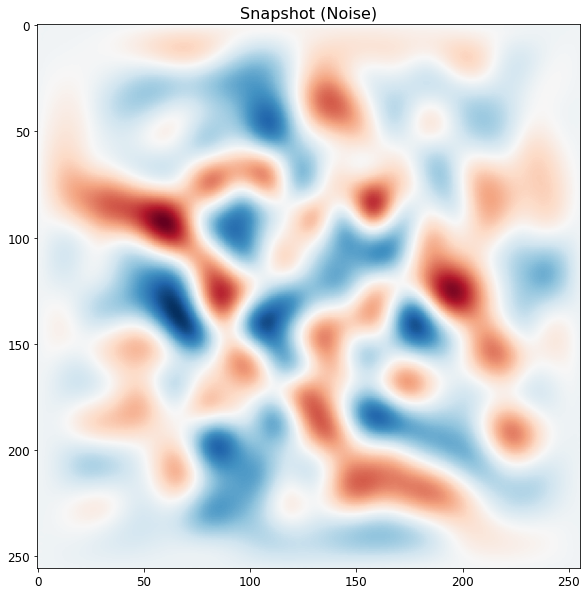

In [ ]:
noise = tf.random.normal([1, latent_space])
generated_image = generator(noise, training=False)
print(generated_image.shape)

fig, ax = plt.subplots(figsize=[10,10])
inv_generated_image = invert_data(generated_image[0, :, :, 0])
print(inv_generated_image.shape)
ax.imshow(inv_generated_image[0, :].reshape(nx, nx), cmap='RdBu');
ax.set_title('Snapshot (Noise)', fontsize=16);

Test disciriminator model

In [ ]:
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[-0.14306796]], shape=(1, 1), dtype=float32)


Generative Model


In [ ]:
gan = tf.keras.models.Sequential ([generator, discriminator])

In [ ]:
# logs to document losses
#version_num = 'E3000_FT'
version_num = 'E3000_64b_wganLRS_02'

generator_log_dir = SAVE_DIR + 'logs/generator_v' + str(version_num) + '_'+ str(num_of_coeff)+'02'
discriminator_log_dir = SAVE_DIR + 'logs/discriminator_v' + str(version_num) + '_'+ str(num_of_coeff)+'02'
gen_summary = tf.summary.create_file_writer(generator_log_dir)
disc_summary = tf.summary.create_file_writer(discriminator_log_dir)


print('Version no.: ', version_num)
print('POD coeffiecients: ', num_of_coeff)
print('Batch size: ', BATCH_SIZE)
print('Learning Rate: ', g_lr, '(gen),', d_lr, '(disc)')
print('Instances: ', ntimes)
print('Time steps: ', step)

Version no.:  E3000_64b_wganLRS_02
POD coeffiecients:  292
Batch size:  64
Learning Rate:  0.0001 (gen), 0.0001 (disc)
Instances:  7
Time steps:  5


Training step

In [ ]:
@tf.function
def train_step(batch, n_critic):
    noise = tf.random.normal([BATCH_SIZE, latent_space])

    # Discriminator training 
    for i in range(n_critic):
      losses_d = [] 
      with tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)
        
        fake_output = discriminator(generated_images, training=True)
        real_output = discriminator(batch, training=True)
        
        # Wasserstein Loss
        disc_wloss_noGP = discriminator_loss(fake_output, real_output)
        gp = gradient_penalty(functools.partial(discriminator, training=True), batch, generated_images)
        disc_wloss = disc_wloss_noGP + gp*10.0
       
      gradients_of_discriminator = disc_tape.gradient(disc_wloss, discriminator.trainable_variables)
      discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
      losses_d.append(disc_wloss_noGP)
    discriminator_mean_loss(losses_d)

    # Generator training 
    with tf.GradientTape() as gen_tape:
        generated_images = generator(noise, training=True)
        fake_output = discriminator(generated_images, training=True)

        # Wasserstein Loss
        gen_wloss = generator_loss(fake_output, real_output)
    
    gradients_of_generator = gen_tape.gradient(gen_wloss, generator.trainable_variables)
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
   
   
    generator_mean_loss(gen_wloss)
    return gp

#### Training GAN

In [ ]:
def train(dataset, epochs, n_critic, cont=0, log=True):
    hist = []
    for epoch in range(epochs+1):
        start = time.time()
        print("Epoch {}/{}".format(epoch + 1+cont, epochs+cont))   

        for batch in dataset:
           gp = train_step(batch, n_critic)

        if log:
          with gen_summary.as_default():
              tf.summary.scalar('loss', generator_mean_loss.result(), step=epoch)

          with disc_summary.as_default():
              tf.summary.scalar('loss', discriminator_mean_loss.result(), step=epoch)
        
        hist.append([generator_mean_loss.result().numpy(), discriminator_mean_loss.result().numpy()])

        generator_mean_loss.reset_states()
        discriminator_mean_loss.reset_states()
        

        print("discriminator loss: ", "{:.7f}".format(hist[-1][1]), end=' - ')
        print("generator loss: ", "{:.7f}".format(hist[-1][0]), end=' - ')
        print("gradient penalty: ", "{:.7f}".format(gp), end=' - ')
        print("lr: ", "{:.2e}".format(generator_optimizer.learning_rate(epoch)), end= ' - ')  
        print ('{:.0f}s'.format( time.time()-start))

        pred_time_len = 4
        # Global variables are used below
        if epoch%100 == 0: 
            # Plot generated data
            X_generated = generator.predict(seed).reshape(-1, num_of_coeff)
            X_generated = invert_data(X_generated)
            print(X_generated.shape)
            X_generated = X_generated.reshape(num_examples_to_generate, ntimes, nx, nx)
            fig, ax = plt.subplots(5, pred_time_len, figsize=[20, 25], constrained_layout=True)
            for j in range(5):
              for i in range(pred_time_len):
                im = ax.flatten()[i + (pred_time_len*j)].imshow(X_generated[j][i,:,:], cmap='RdBu')
                ax[j,i].set_xticklabels([]), ax[j,i].set_yticklabels([])
              fig.colorbar(im, ax=ax[j,:], location='right', shrink=0.8, pad=0.05)
            plt.show() 
                    
            
            # plot loss
            print('Loss: ')
            fig, ax = plt.subplots(1,1, figsize=[20,10])
            ax.plot(hist)
            ax.legend(['loss_gen', 'loss_disc'])
            #ax.set_yscale('log')
            ax.grid()
            plt.show()
        if epoch%500 == 0 and epoch>0:          
            # Save model once 
            gan.save(SAVE_DIR + 'ganmodels/model_v'+ str(version_num) + '_'+ 
                                          str(num_of_coeff)+'_'+str(epoch+cont) + '.h5')  
    return hist

In [ ]:
import time
hist = train(train_dataset, epochs=15000, cont=1500, n_critic=3) 

#**Prediction with WGAN-GP**

In [ ]:
import warnings
warnings.filterwarnings('ignore')

In [ ]:
 from tensorflow.keras.models import load_model
 # arbitrary sample trajectories to predict
ns = [3782, 3792, 5007, 4294, 4284, 4274, 3004, 2517, 2909, 5734]
model_dir_arr = ['ganmodels/E3000/model_vE3000_125b_wganHalfLR_292_second_39500.h5',
                 'ganmodels/E3000/model_vE3000_125b_wganHalfLR_292_second_33500.h5',
                 'ganmodels/E3000/model_vE3000_64b_wgan_01_292_4500.h5',
                 'ganmodels/E3000/model_vE3000_64b_wgan_01_292_7500.h5',
                 'ganmodels/E3000/model_vE3000_125b_wgan_292_second_11000.h5',
                 'ganmodels/E3000/model_vE3000_125b_wgan_292_second_17000.h5',
                 'ganmodels/E3000/model_vE3000_125b_wgan_292_second_18000.h5',
             ]
models_generator={}

models_pred={}  
models_pred_time={}
models_pred_mse_err={}
models_pred_mae_err={}
models_opt_latent={}

### Sample generation

In [ ]:
def generate_samples(model_dir, model_idx):
  generator, discriminator = load_model(SAVE_DIR+model_dir).layers;
  models_generator[model_idx] = generator
  print()
  print('------------------------------')
  print(model_dir)
  print('------------------------------')
  np.random.seed(0)
  tf.random.set_seed(0)
  npredict = 10
  latent_size = 3000
  pred_time_len = 7
  noise = tf.random.normal(shape=[npredict, latent_size])
  X_generated = generator.predict(noise).reshape(-1, num_of_coeff)
  X_generated = invert_data3(X_generated)
  X_generated = X_generated.reshape(npredict, ntimes, nx, ny)

  for j in range(npredict):
    fig, ax = plt.subplots(1, pred_time_len, figsize=[20, 16], constrained_layout=True)
    for i in range(pred_time_len):
      im = ax.flatten()[i].imshow(X_generated[j][i,:,:], cmap='RdBu')
      ax[i].set_xticklabels([]), ax[i].set_yticklabels([])
    fig.colorbar(im, ax=ax[:], location='right', shrink=0.18, pad=0.05)
    plt.show() 



------------------------------
ganmodels/E3000/model_vE3000_125b_wganHalfLR_292_second_39500.h5
------------------------------


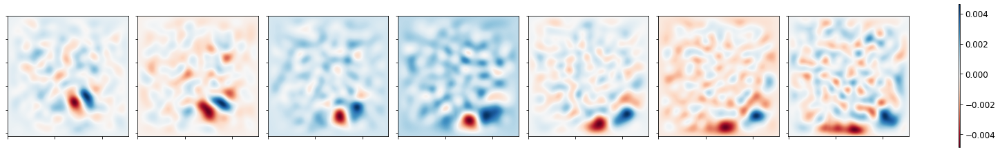

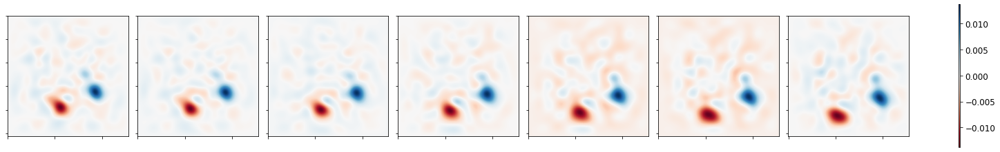

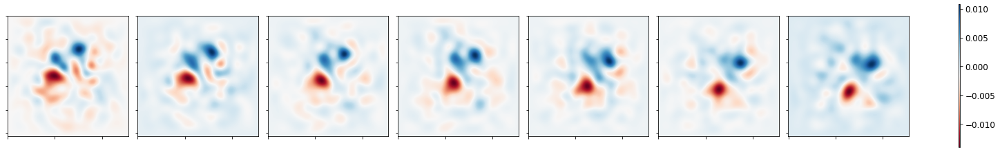

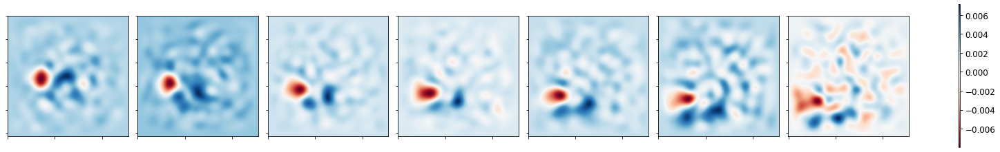

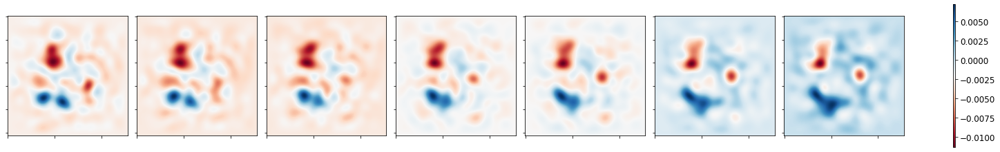

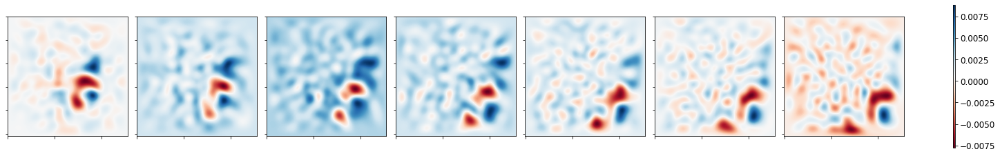

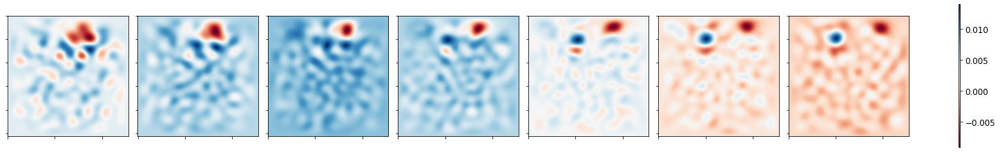

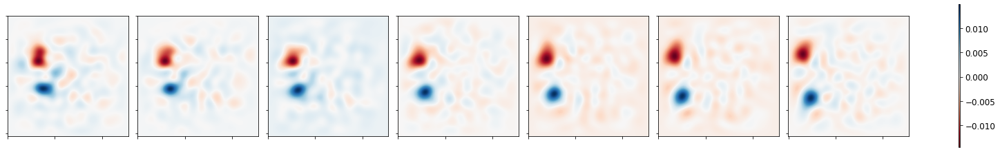

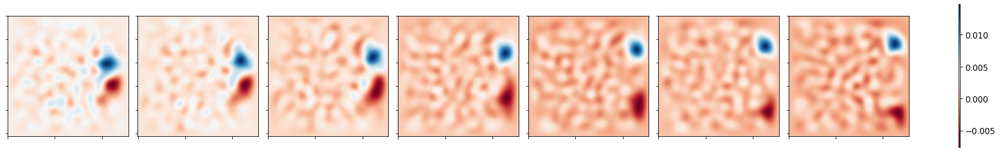

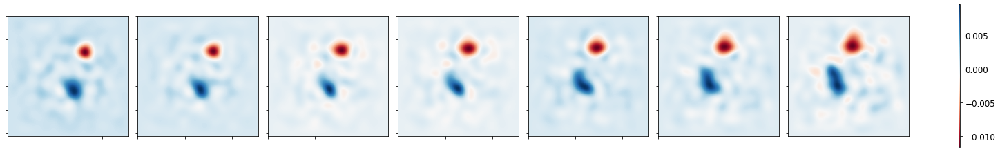

In [ ]:
generate_samples(model_dir_arr[0], 0)



------------------------------
ganmodels/E3000/model_vE3000_125b_wganHalfLR_292_second_33500.h5
------------------------------


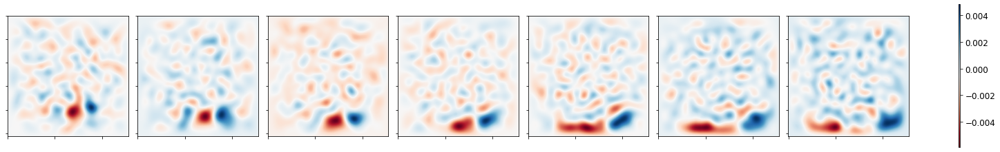

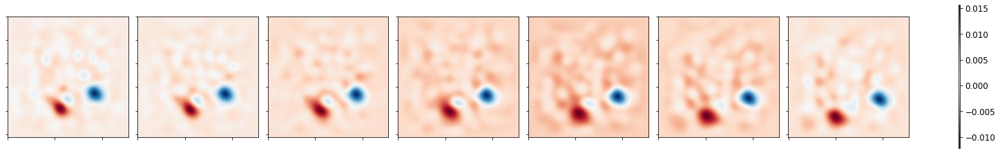

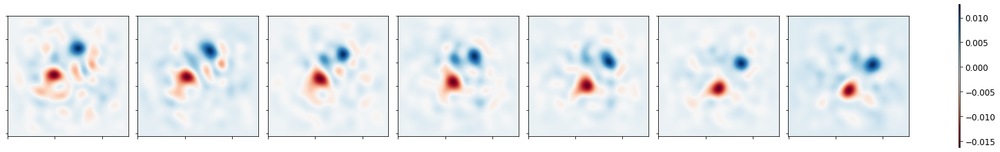

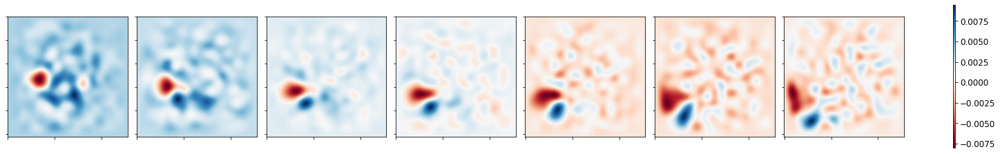

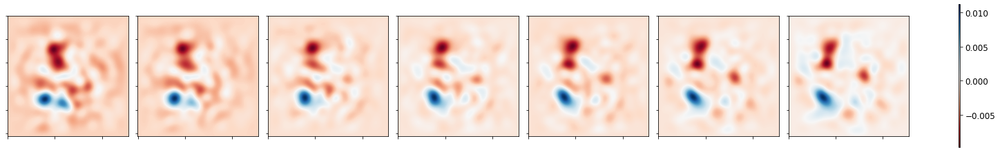

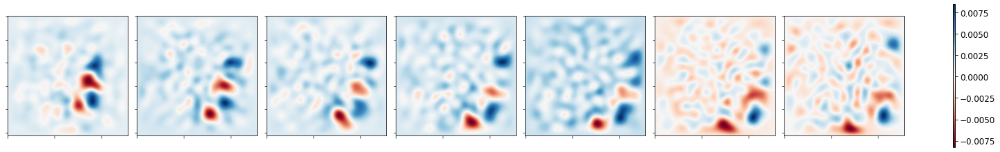

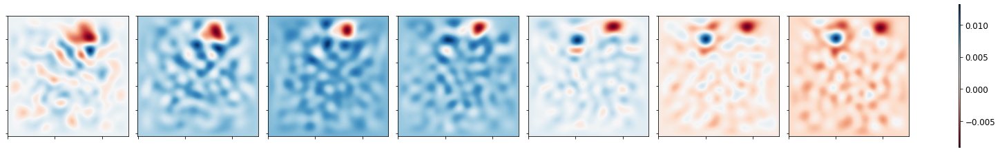

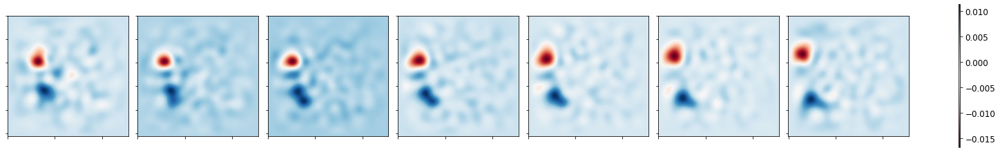

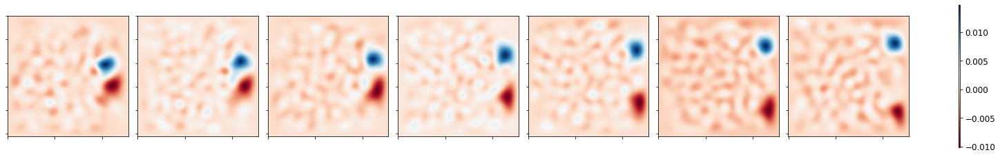

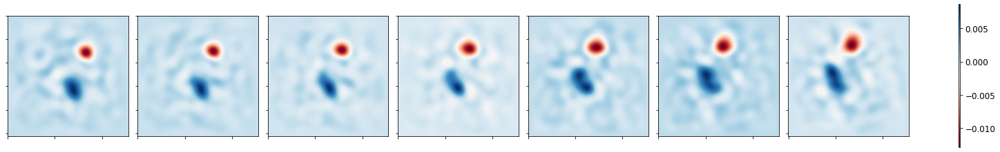

In [ ]:
generate_samples(model_dir_arr[1], 1)


------------------------------
ganmodels/E3000/model_vE3000_64b_wgan_01_292_4500.h5
------------------------------


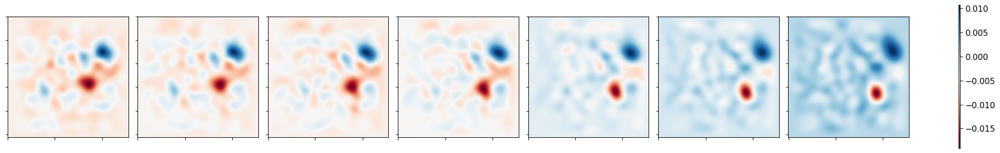

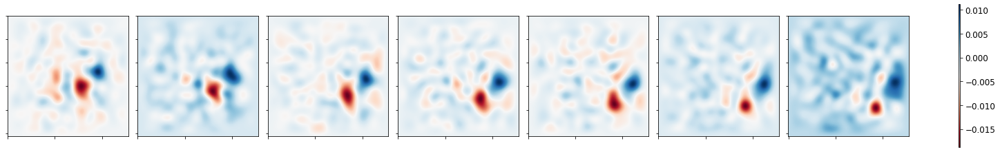

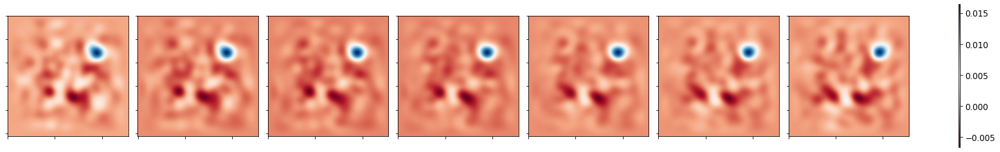

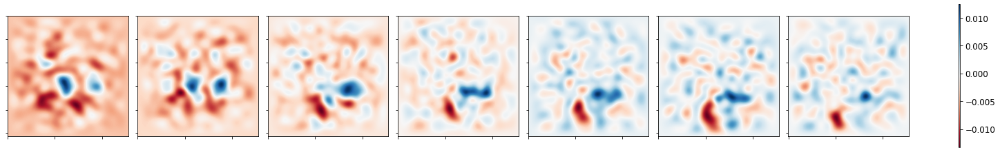

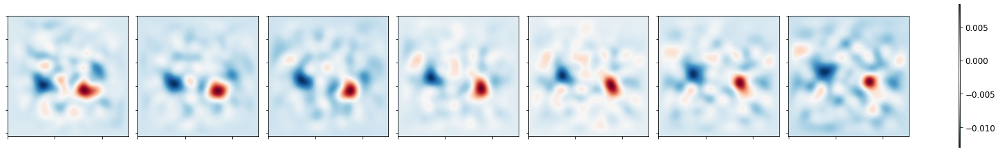

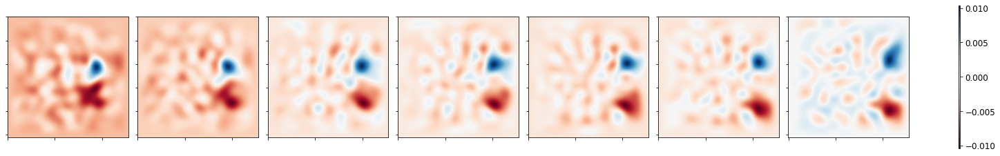

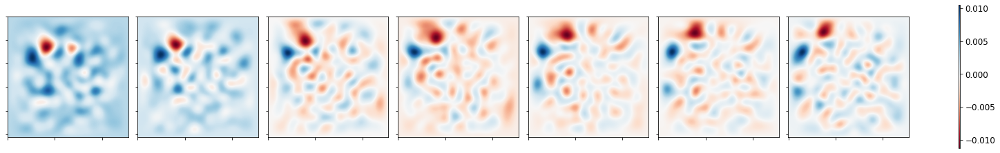

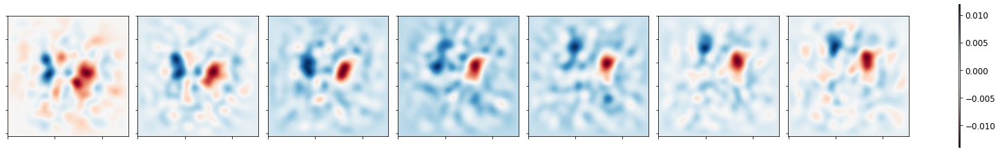

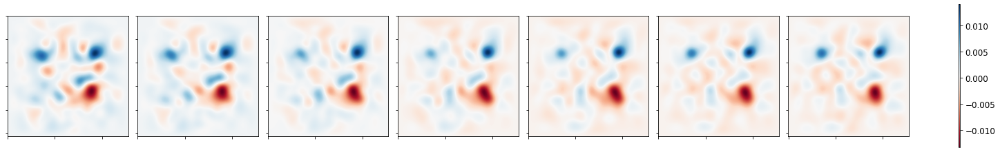

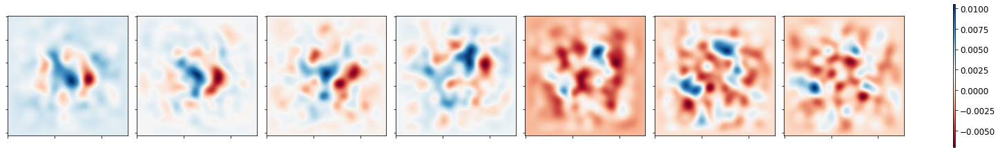

In [ ]:
generate_samples(model_dir_arr[2], 2)


------------------------------
ganmodels/E3000/model_vE3000_64b_wgan_01_292_7500.h5
------------------------------


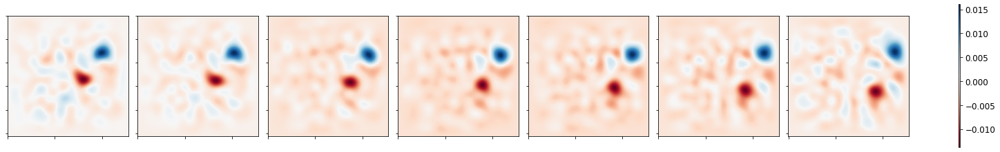

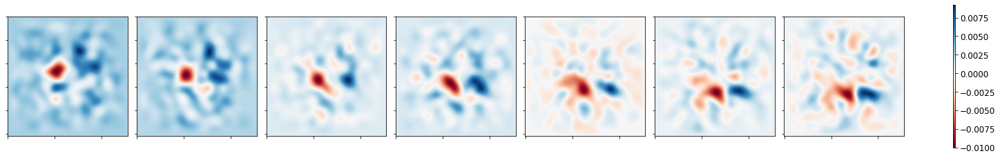

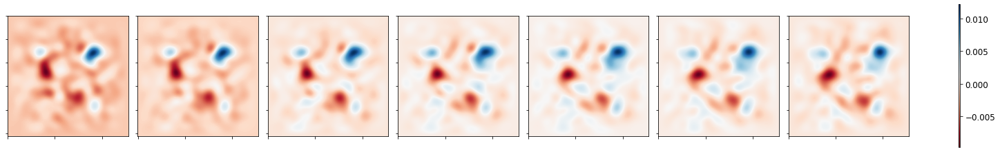

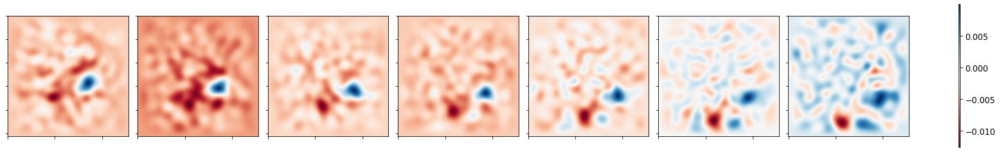

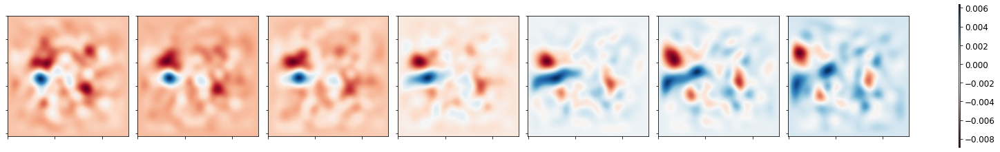

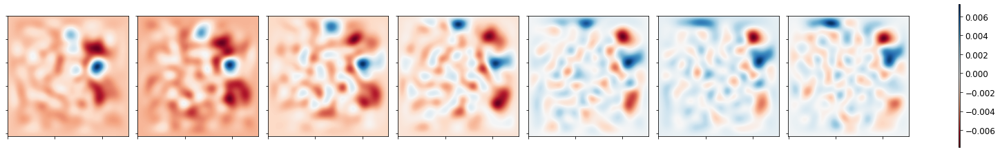

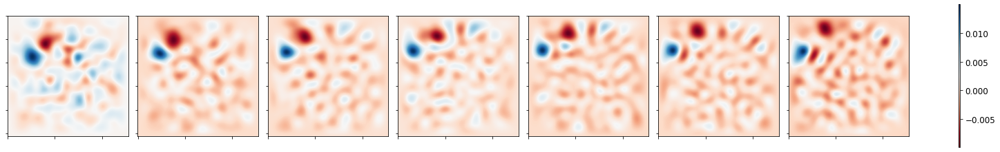

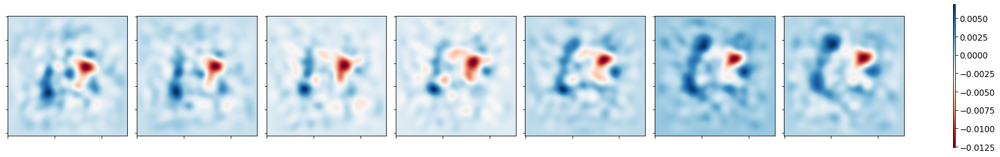

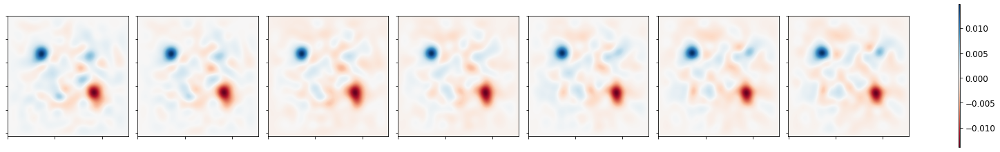

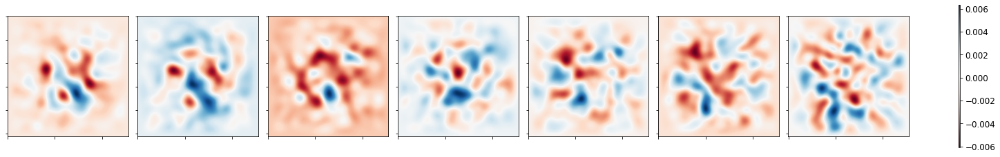

In [ ]:
generate_samples(model_dir_arr[3], 3)


------------------------------
ganmodels/E3000/model_vE3000_125b_wgan_292_second_11000.h5
------------------------------


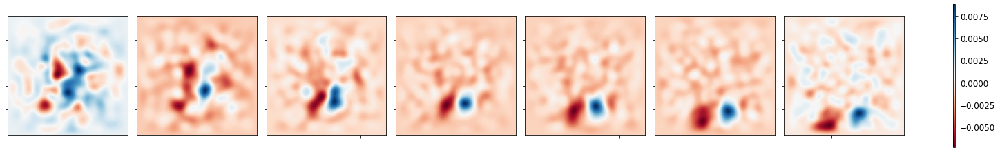

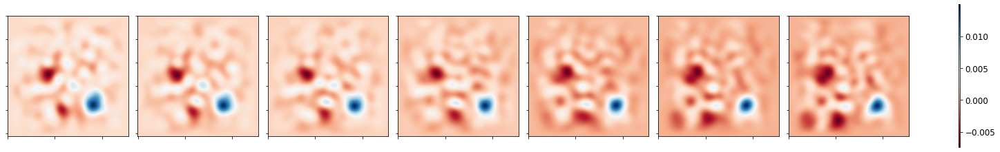

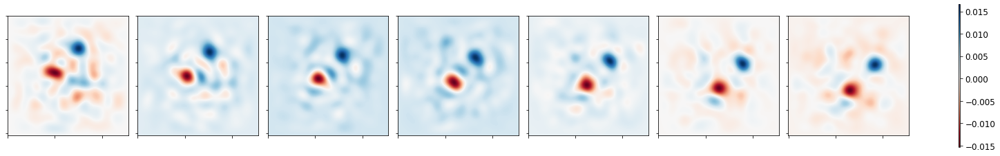

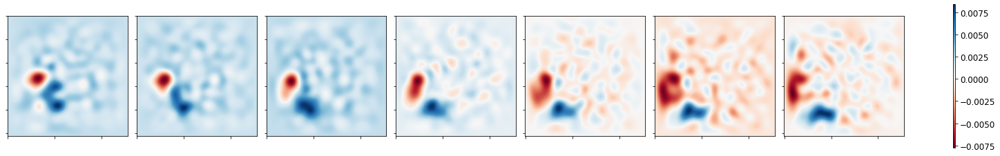

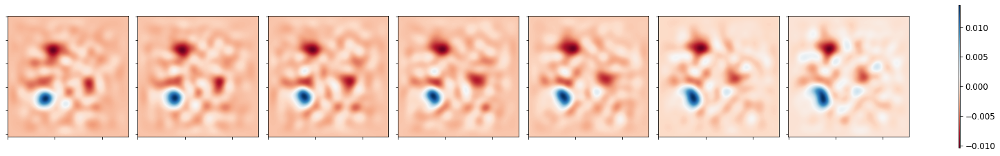

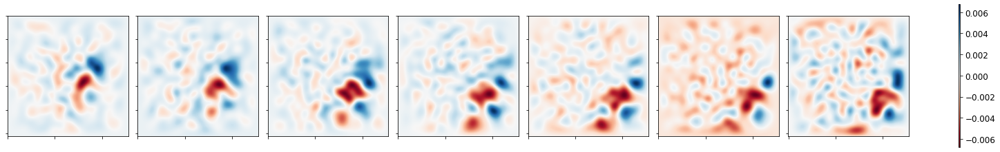

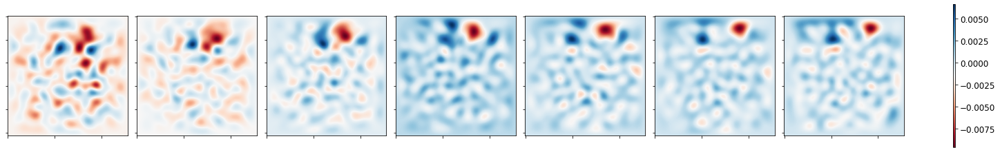

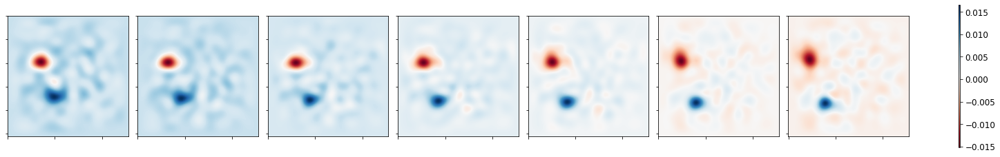

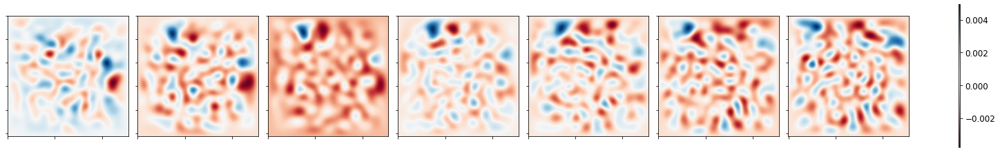

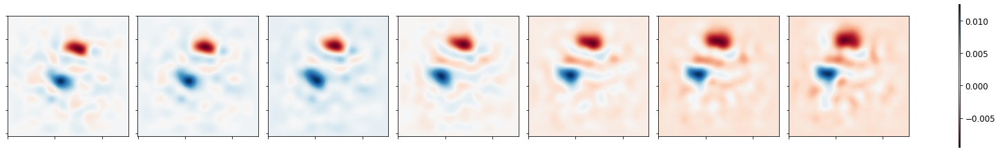

In [ ]:
generate_samples(model_dir_arr[4], 4)


------------------------------
ganmodels/E3000/model_vE3000_125b_wgan_292_second_17000.h5
------------------------------


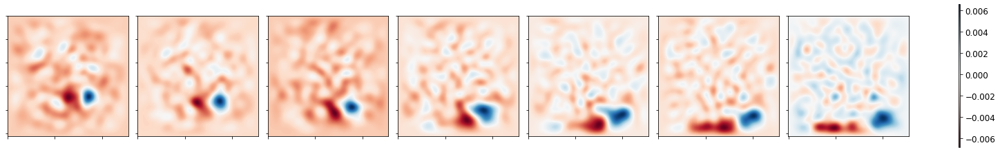

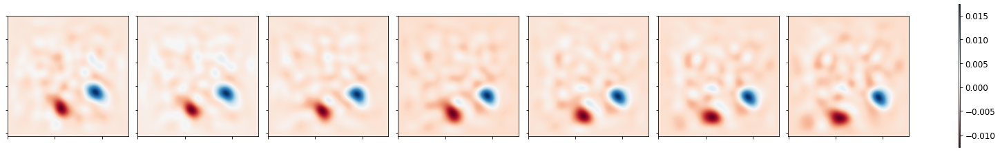

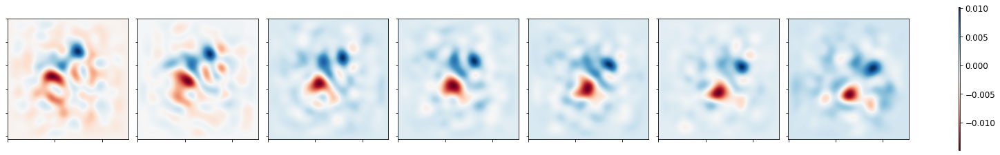

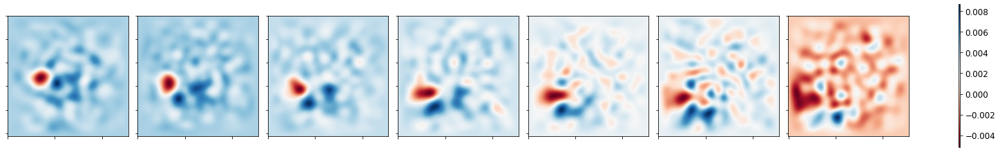

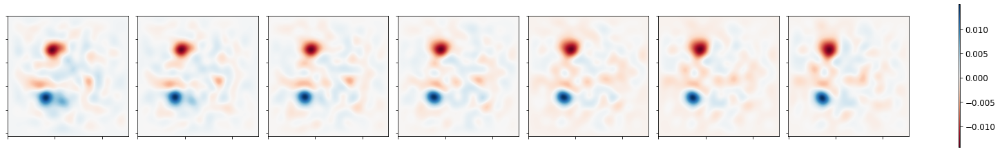

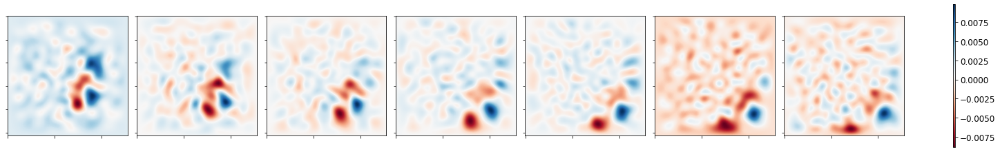

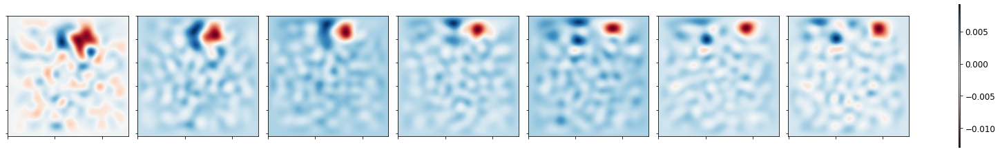

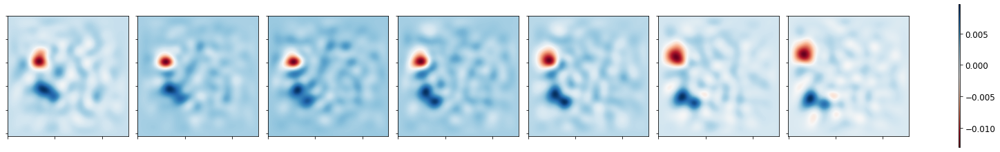

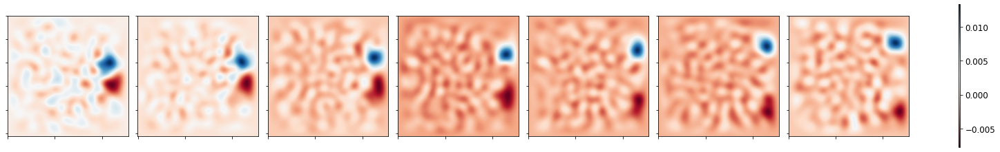

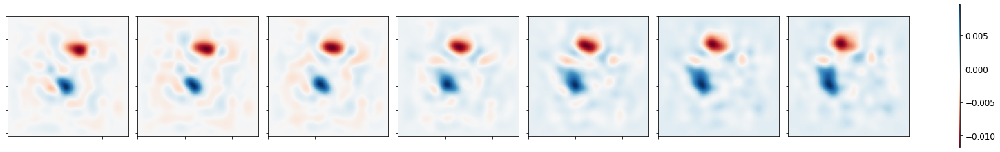

In [ ]:
generate_samples(model_dir_arr[5], 5)


------------------------------
ganmodels/E3000/model_vE3000_125b_wgan_292_second_18000.h5
------------------------------


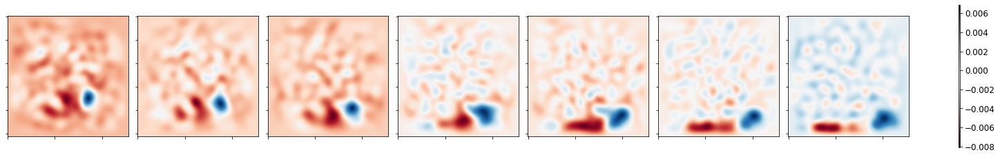

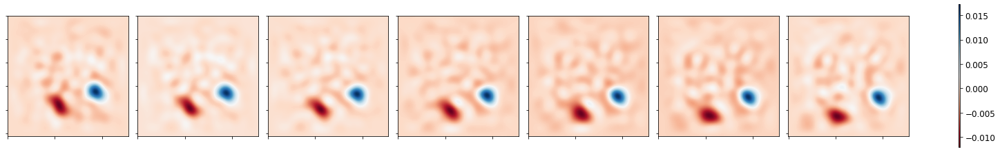

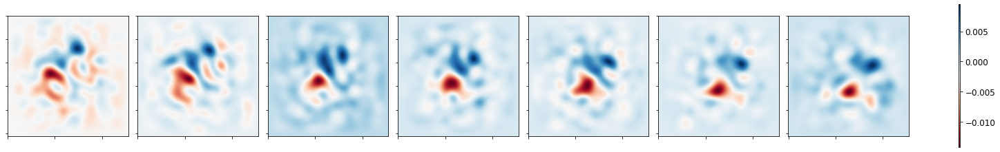

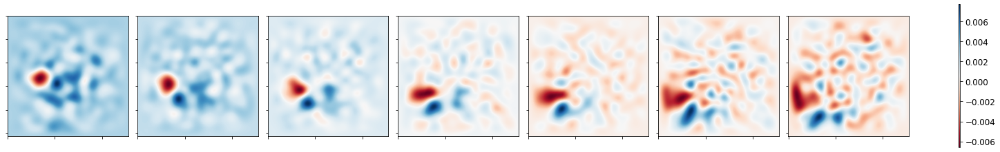

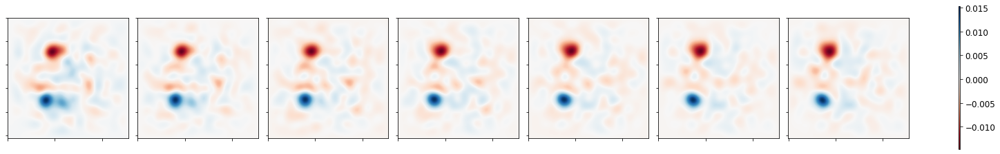

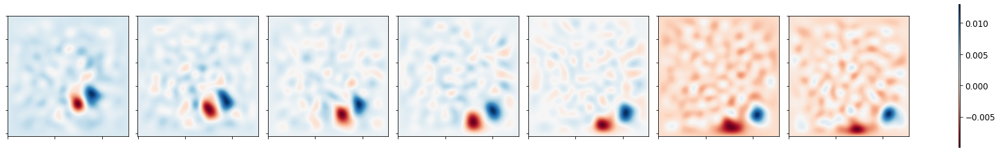

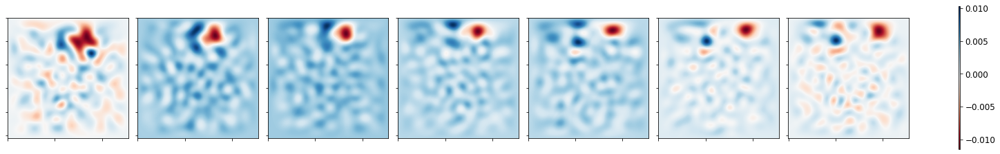

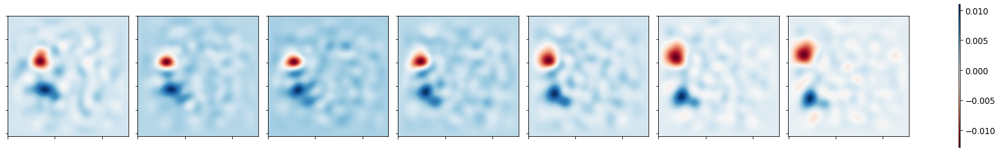

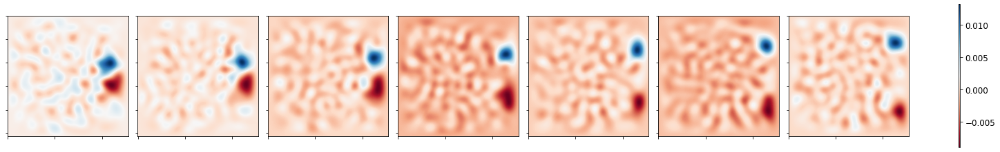

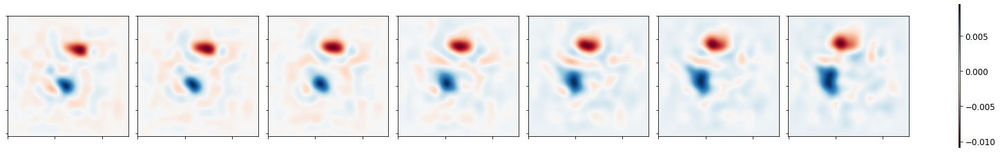

In [ ]:
generate_samples(model_dir_arr[6], 6)

### Predict a point in time

In [ ]:
class Pred():
  def __init__(self, n, ntimes, codings_size, weight):
    pass
  
  def get_data (self):
      real_coding = X_train_concat_flatten[n].reshape(1,-1)
      real_coding = tf.constant(real_coding[:,:codings_size*(ntimes - 1)])
      real_coding = tf.cast(real_coding, dtype=tf.float32)

In [ ]:
class Pred_optimizer():
  def __init__(self, generator, real_coding, weights, latent_values,
               loss_metric=tf.keras.losses.MeanSquaredError(), 
               optimizer=tf.keras.optimizers.Adam(1e-2), ntimes=7):
      self.generator = generator
      self.real_coding = real_coding
      self.weights = weights
      self.loss_metric = loss_metric
      self.optimizer = optimizer
      self.latent_values = latent_values
      self.ntimes = ntimes

  @tf.function
  def opt_step(self):
      with tf.GradientTape() as tape:
        tape.watch(self.latent_values)
        gen_output = self.generator(self.latent_values, training=False)  #results from generato
        
        codings_size = self.weights.shape[0]
        true_val = tf.reshape(self.real_coding, [-1, codings_size]) 
        gen_val = tf.reshape(gen_output[:,:(self.ntimes - 1),:,:], [-1, codings_size]) 

        loss = self.loss_metric(true_val, gen_val)   

      gradient = tape.gradient(loss, self.latent_values)   #gradient of the loss ws to the input
      self.optimizer.apply_gradients(zip([gradient], [self.latent_values]))   #applies gradients to the input
      return loss
  
  def __call__(self, opt_epochs, num_call=1):
      
      loss = []
      step_loss = 1
      for epoch in range(opt_epochs):
        step_loss = self.opt_step().numpy()
        loss.append(step_loss)
      plt.plot(loss, label='Loss_'+str(num_call))
      plt.grid()
      plt.legend()
      plt.show
        
      return self.latent_values, loss[-1]

#### Sample run  with train data 1

In [ ]:
latent_size=3000
codings_size = 292
n = ns[-4] 
opt_epochs = 10000
weight = tf.constant(pca3.singular_values_, dtype=tf.float32)

real_coding = X_train_concat_flatten3[n+5].reshape(1,-1)
real_coding = tf.constant(real_coding[:,:codings_size*(ntimes - 1)])
real_coding = tf.cast(real_coding, dtype=tf.float32)

mse = tf.keras.losses.MeanSquaredError()
codings_size = num_of_coeff
mse = tf.keras.losses.MeanSquaredError()
mae = tf.keras.losses.MeanAbsoluteError()
optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)
latent_values = tf.Variable(tf.random.normal([len(real_coding), latent_size]))


def mse_loss(inp, outp):
    inp = tf.reshape(inp, [-1, codings_size]) *tf.math.sqrt(weight)
    outp = tf.reshape(outp, [-1, codings_size]) *tf.math.sqrt(weight)
    return mse(inp, outp)

def mae_loss(inp, outp):
    inp = tf.reshape(inp, [-1, codings_size])*weight
    outp = tf.reshape(outp, [-1, codings_size])*weight
    return mae(inp, outp)

def predict_timelvl(generator, n, model_idx):
    list_latent_values = []
    list_loss = []
    start = time.time()
    for i in range(7):

        latent_values = tf.Variable(tf.random.normal([len(real_coding), latent_size]))
        # instantiating prediction optimizer
        pred_optim = Pred_optimizer(generator, real_coding, weight, latent_values, mse_loss, optimizer)
        opt_latent_values, loss = pred_optim(opt_epochs=opt_epochs, num_call=i)
        list_latent_values.append(opt_latent_values)
        list_loss.append(loss)

    latent_values = list_latent_values[np.argmin(list_loss)]
    # print('Initial point losses: ', end=' - ')
    # print(list_loss)
    time_to_pred = time.time()-start
    print('{:.0f}s'.format( time_to_pred))
  
    l_mse = mse_loss(generator(opt_latent_values)[:,:(ntimes - 1),:,:], real_coding).numpy()
    l_mae = mae_loss(generator(opt_latent_values)[:,:(ntimes - 1),:,:], real_coding).numpy()
    print('MSE Loss: ', l_mse)
    print('MAE Loss: ', l_mae)

    models_pred_mse_err[model_idx] = l_mse
    models_pred_mae_err[model_idx] = l_mae
    models_pred_time[model_idx] = time_to_pred
    models_opt_latent[model_idx] = opt_latent_values

**Original trajectory**

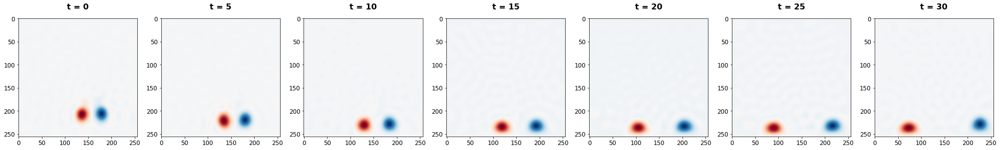

In [ ]:
times = [i for i in range(ntimes)]
X_real = X_train_concat_flatten3[n+5].reshape(ntimes,codings_size)
X_real = invert_data3(X_real)
X_real = X_real.reshape(ntimes, nx*nx)
times = [i for i in range(ntimes)]
plot_vortex(X_real.reshape(ntimes, nx, nx), times, 7, c_bar=False, skips=5)

**Prediction Algorithm**

287s
MSE Loss:  0.006425044
MAE Loss:  0.08536911


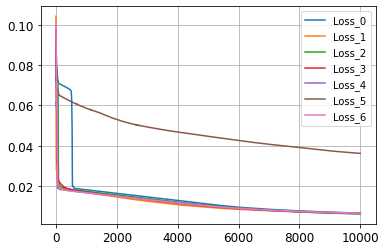

In [ ]:
predict_timelvl(models_generator[0], n, 0)

288s
MSE Loss:  0.036041994
MAE Loss:  0.21976034


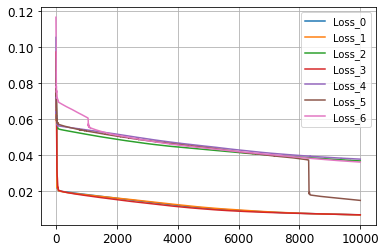

In [ ]:
predict_timelvl(models_generator[1], n, 1)

266s
MSE Loss:  0.005267793
MAE Loss:  0.07559653


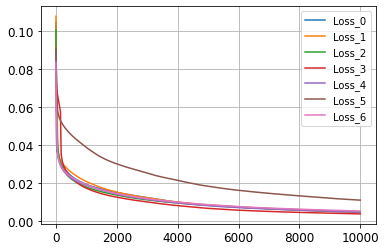

In [ ]:
predict_timelvl(models_generator[2], n, 2)

267s
MSE Loss:  0.0051827286
MAE Loss:  0.07988466


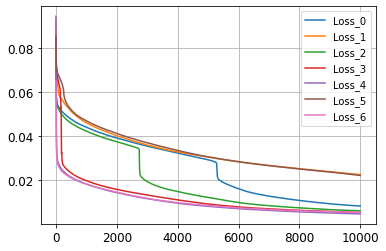

In [ ]:
predict_timelvl(models_generator[3], n, 3)

285s
MSE Loss:  0.031709407
MAE Loss:  0.2091558


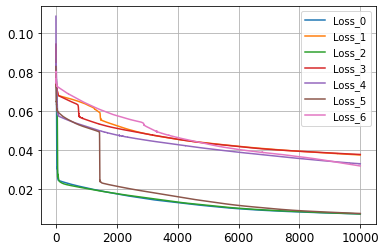

In [ ]:
predict_timelvl(models_generator[4], n, 4)

285s
MSE Loss:  0.007239389
MAE Loss:  0.093385965


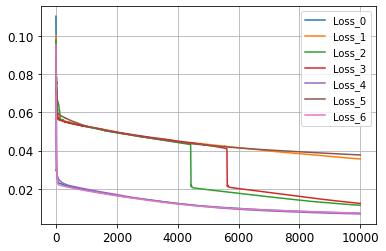

In [ ]:
predict_timelvl(models_generator[5], n, 5)

285s
MSE Loss:  0.03322339
MAE Loss:  0.21375366


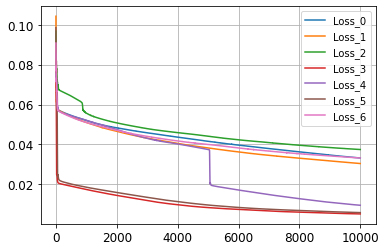

In [ ]:
predict_timelvl(models_generator[6], n, 6)

**Generated Data**

In [ ]:
def gen_pred_timelvl(generator, opt_lat_val, model_idx):
  print(model_dir_arr[model_idx])
  print('--------------------------')
  print()
  X_gen = generator.predict(np.asarray(opt_lat_val)).reshape(ntimes,codings_size)
  models_pred[model_idx] = X_gen
  X_gen = invert_data3(X_gen)
  X_gen = X_gen.reshape(ntimes, nx*nx)
  plot_vortex(X_gen.reshape(ntimes, nx, nx), times, 7, c_bar=False, skips=5)

ganmodels/E3000/model_vE3000_125b_wganHalfLR_292_second_39500.h5
--------------------------



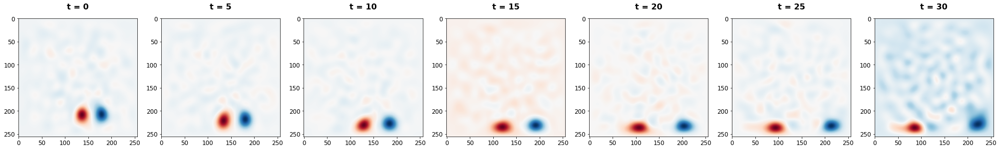

In [ ]:
gen_pred_timelvl(models_generator[0], models_opt_latent[0], 0)

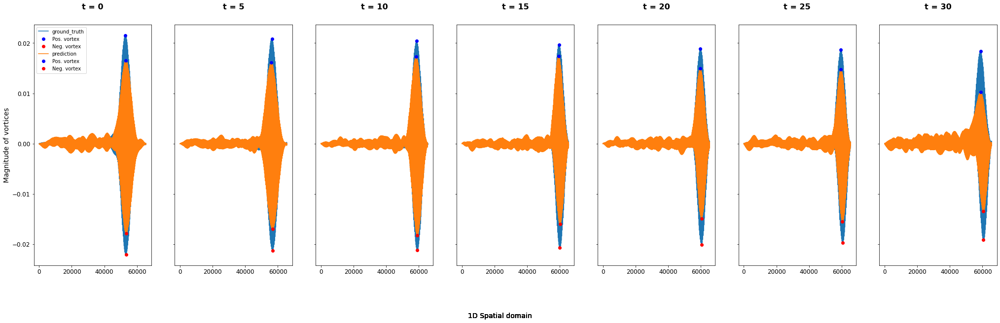

In [ ]:
X_gen = invert_data3(models_pred[0])
X_gen = X_gen.reshape(ntimes, nx*nx)
plot_dict = { 'ground_truth': X_real, 'prediction': X_gen}
plot_linevortex(plot_dict, times, len(times), skips=5)

ganmodels/E3000/model_vE3000_125b_wganHalfLR_292_second_33500.h5
--------------------------



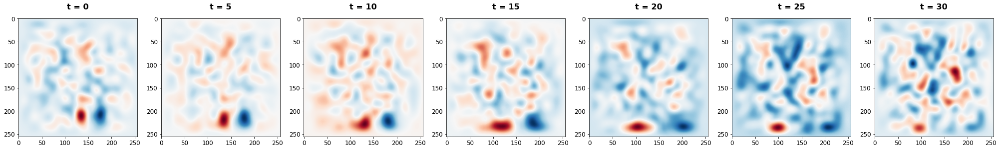

In [ ]:
gen_pred_timelvl(models_generator[1], models_opt_latent[1], 1)

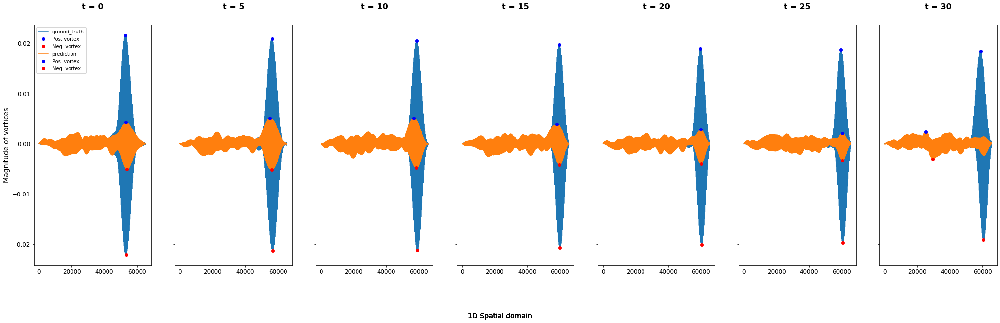

In [ ]:
X_gen = invert_data3(models_pred[1])
X_gen = X_gen.reshape(ntimes, nx*nx)
plot_dict = { 'ground_truth': X_real, 'prediction': X_gen}
plot_linevortex(plot_dict, times, len(times), skips=5)

ganmodels/E3000/model_vE3000_64b_wgan_01_292_4500.h5
--------------------------



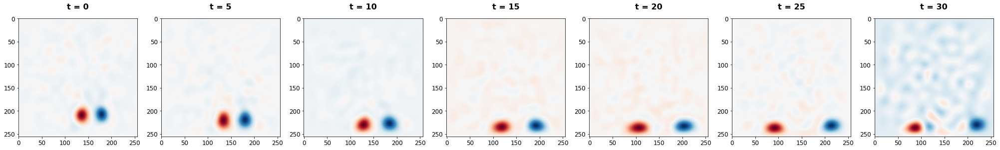

In [ ]:
gen_pred_timelvl(models_generator[2], models_opt_latent[2], 2)

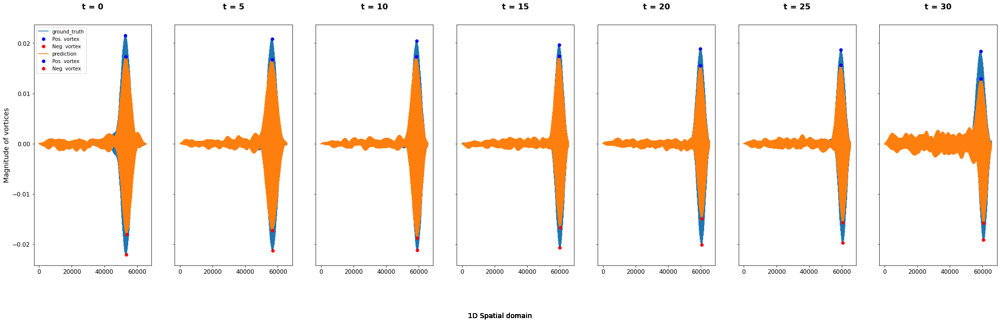

In [ ]:
X_gen = invert_data3(models_pred[2])
X_gen = X_gen.reshape(ntimes, nx*nx)
plot_dict = { 'ground_truth': X_real, 'prediction': X_gen}
plot_linevortex(plot_dict, times, len(times), skips=5)

ganmodels/E3000/model_vE3000_64b_wgan_01_292_7500.h5
--------------------------



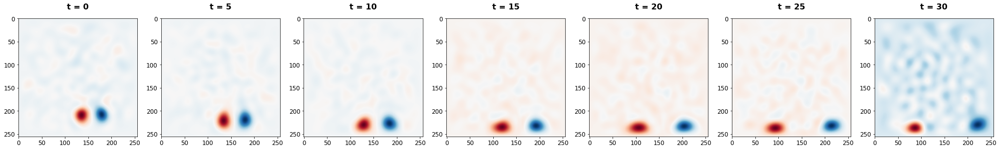

In [ ]:
gen_pred_timelvl(models_generator[3], models_opt_latent[3], 3)

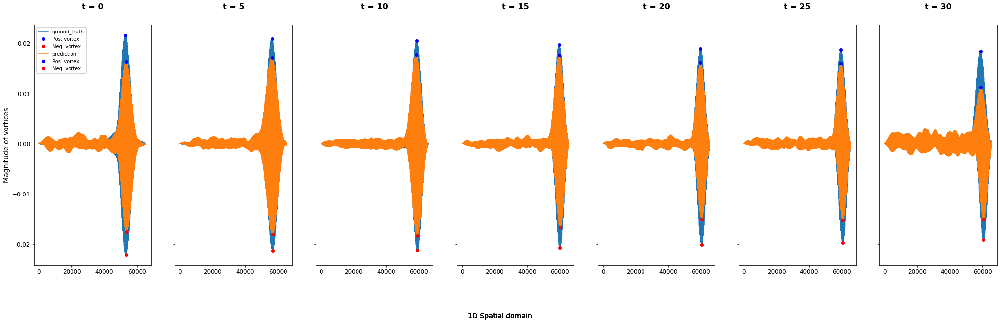

In [ ]:
X_gen = invert_data3(models_pred[3])
X_gen = X_gen.reshape(ntimes, nx*nx)
plot_dict = { 'ground_truth': X_real, 'prediction': X_gen}
plot_linevortex(plot_dict, times, len(times), skips=5)

ganmodels/E3000/model_vE3000_125b_wgan_292_second_11000.h5
--------------------------



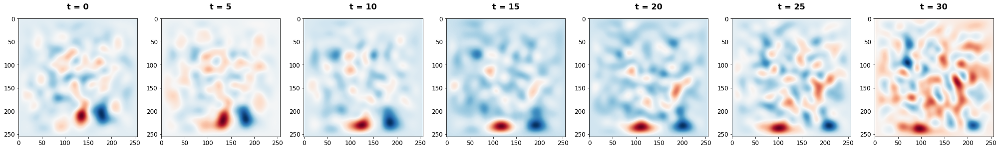

In [ ]:
gen_pred_timelvl(models_generator[4], models_opt_latent[4], 4)

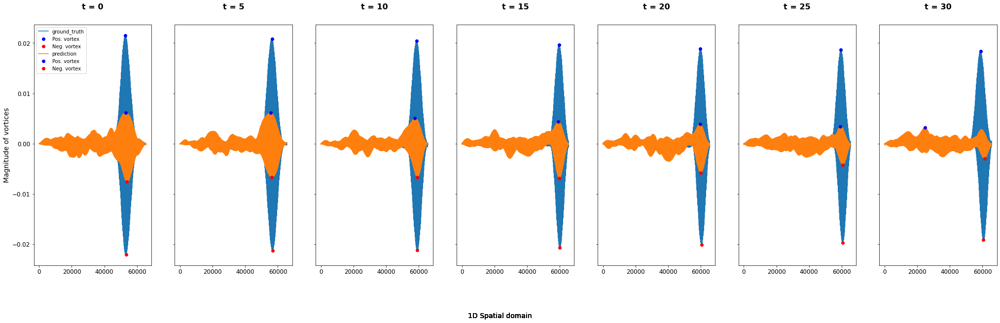

In [ ]:
X_gen = invert_data3(models_pred[4])
X_gen = X_gen.reshape(ntimes, nx*nx)
plot_dict = { 'ground_truth': X_real, 'prediction': X_gen}
plot_linevortex(plot_dict, times, len(times), skips=5)

ganmodels/E3000/model_vE3000_125b_wgan_292_second_17000.h5
--------------------------



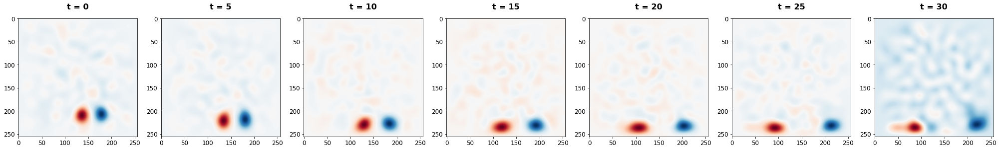

In [ ]:
gen_pred_timelvl(models_generator[5], models_opt_latent[5], 5)

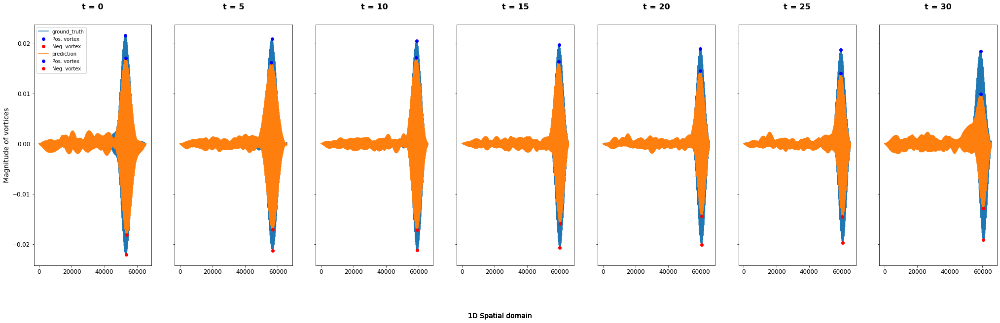

In [ ]:
X_gen = invert_data3(models_pred[5])
X_gen = X_gen.reshape(ntimes, nx*nx)
plot_dict = { 'ground_truth': X_real, 'prediction': X_gen}
plot_linevortex(plot_dict, times, len(times), skips=5)

ganmodels/E3000/model_vE3000_125b_wgan_292_second_18000.h5
--------------------------



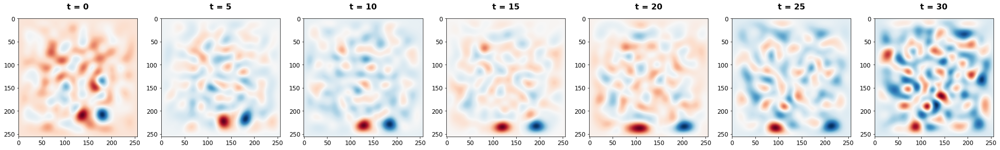

In [ ]:
gen_pred_timelvl(models_generator[6], models_opt_latent[6], 6)

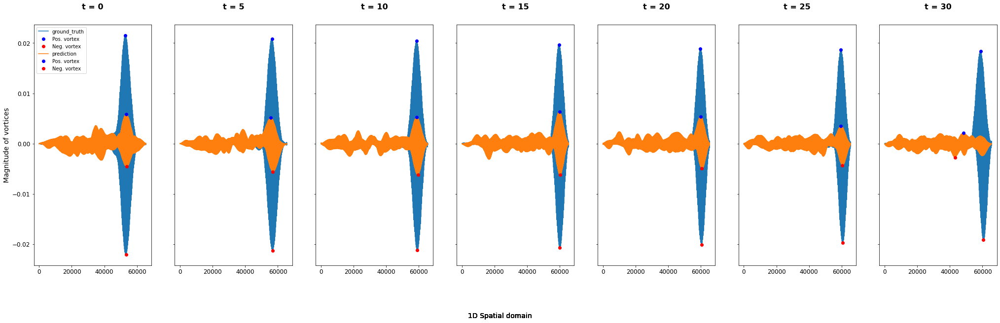

In [ ]:
X_gen = invert_data3(models_pred[6])
X_gen = X_gen.reshape(ntimes, nx*nx)
plot_dict = { 'ground_truth': X_real, 'prediction': X_gen}
plot_linevortex(plot_dict, times, len(times), skips=5)

In [ ]:
print(np.max(X_gen[-1]))

0.013330745368535289


**Comparing Predicted and Real Data**

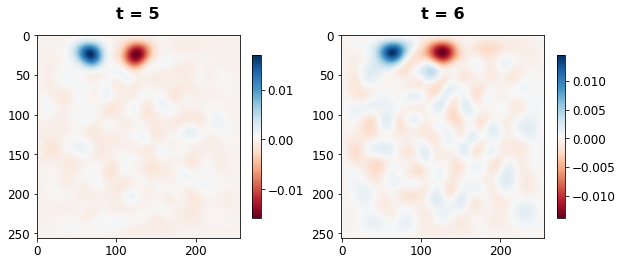

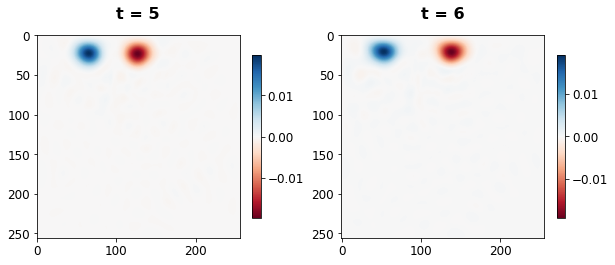

In [ ]:
plot_vortex(X_gen.reshape(ntimes, nx, nx), [ntimes-2, ntimes-1], 2)
plot_vortex(X_real.reshape(ntimes, nx, nx), [ntimes-2, ntimes-1],2)

In [ ]:
real = X_real.reshape(ntimes, nx, nx)
generated = X_gen.reshape(ntimes, nx, nx)
X_diff = real - generated
print('Mean Error: ', np.mean(X_diff))
print('Max. Error: ', np.max(X_diff))
# plot_vortex(X_diff, times, 4, 2)

Mean Error:  -4.4248697425984146e-07
Max. Error:  0.009921253653360607


#### Sample run with train data 2

In [ ]:
models_pred2={}  
models_pred_time2={}
models_pred_mse_err2={}
models_pred_mae_err2={}
models_opt_latent2={}

In [ ]:
latent_size=3000
codings_size = 292
n = 4260 
opt_epochs = 10000
weight = tf.constant(pca3.singular_values_, dtype=tf.float32)

real_coding = X_train_concat_flatten3[n+5].reshape(1,-1)
real_coding = tf.constant(real_coding[:,:codings_size*(ntimes - 1)])
real_coding = tf.cast(real_coding, dtype=tf.float32)

mse = tf.keras.losses.MeanSquaredError()
codings_size = num_of_coeff
mse = tf.keras.losses.MeanSquaredError()
mae = tf.keras.losses.MeanAbsoluteError()
optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)
latent_values = tf.Variable(tf.random.normal([len(real_coding), latent_size]))


def mse_loss(inp, outp):
    inp = tf.reshape(inp, [-1, codings_size]) *tf.math.sqrt(weight)
    outp = tf.reshape(outp, [-1, codings_size]) *tf.math.sqrt(weight)
    return mse(inp, outp)

def mae_loss(inp, outp):
    inp = tf.reshape(inp, [-1, codings_size])*weight
    outp = tf.reshape(outp, [-1, codings_size])*weight
    return mae(inp, outp)

def predict_timelvl2(generator, n, model_idx):
    list_latent_values = []
    list_loss = []
    start = time.time()
    print(model_dir_arr[model_idx])
    print("------------------------")
    print()
    for i in range(7):

        latent_values = tf.Variable(tf.random.normal([len(real_coding), latent_size]))
        # instantiating prediction optimizer
        pred_optim = Pred_optimizer(generator, real_coding, weight, latent_values, mse_loss, optimizer)
        opt_latent_values, loss = pred_optim(opt_epochs=opt_epochs, num_call=i)
        list_latent_values.append(opt_latent_values)
        list_loss.append(loss)

    opt_latent_values = list_latent_values[np.argmin(list_loss)]
    # print('Initial point losses: ', end=' - ')
    # print(list_loss)
    time_to_pred = time.time()-start
    print('{:.0f}s'.format( time_to_pred))
  
    l_mse = mse_loss(generator(opt_latent_values)[:,:(ntimes - 1),:,:], real_coding).numpy()
    l_mae = mae_loss(generator(opt_latent_values)[:,:(ntimes - 1),:,:], real_coding).numpy()
    print('MSE Loss: ', l_mse)
    print('MAE Loss: ', l_mae)

    models_pred_mse_err2[model_idx] = l_mse
    models_pred_mae_err2[model_idx] = l_mae
    models_pred_time2[model_idx] = time_to_pred
    models_opt_latent2[model_idx] = opt_latent_values

**Original Trajectory**

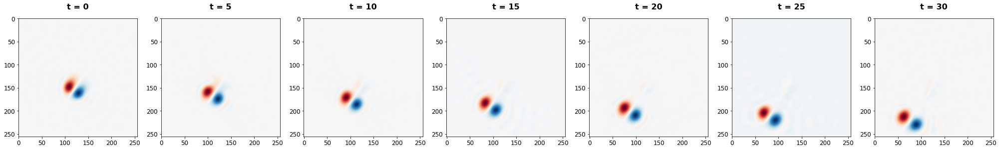

In [ ]:
times = [i for i in range(ntimes)]
X_real2 = X_train_concat_flatten3[n+5].reshape(ntimes,codings_size)
X_real2 = invert_data3(X_real2)
X_real2 = X_real2.reshape(ntimes, nx*nx)
times = [i for i in range(ntimes)]
plot_vortex(X_real2.reshape(ntimes, nx, nx), times, 7, c_bar=False, skips=5)

**Prediction Algorithm**

ganmodels/E3000/model_vE3000_125b_wganHalfLR_292_second_39500.h5
------------------------

285s
MSE Loss:  0.0062778853
MAE Loss:  0.08971676


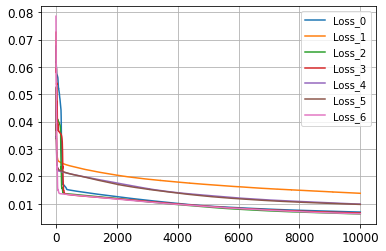

In [ ]:
predict_timelvl2(models_generator[0], n, 0)

ganmodels/E3000/model_vE3000_125b_wganHalfLR_292_second_33500.h5
------------------------

288s
MSE Loss:  0.006117334
MAE Loss:  0.08868632


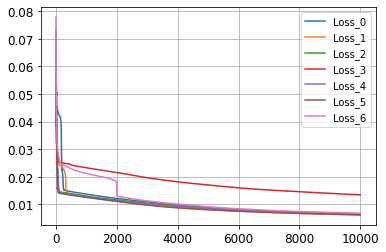

In [ ]:
predict_timelvl2(models_generator[1], n, 1)

ganmodels/E3000/model_vE3000_64b_wgan_01_292_4500.h5
------------------------

267s
MSE Loss:  0.003035274
MAE Loss:  0.06200859


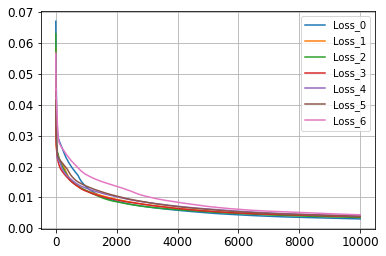

In [ ]:
predict_timelvl2(models_generator[2], n, 2)

ganmodels/E3000/model_vE3000_64b_wgan_01_292_7500.h5
------------------------

268s
MSE Loss:  0.0048112175
MAE Loss:  0.08153781


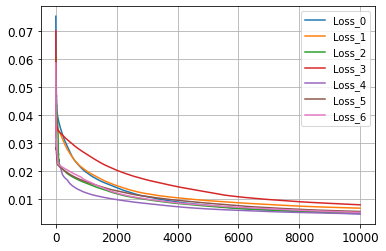

In [ ]:
predict_timelvl2(models_generator[3], n, 3)

ganmodels/E3000/model_vE3000_125b_wgan_292_second_11000.h5
------------------------

286s
MSE Loss:  0.0060498654
MAE Loss:  0.089340426


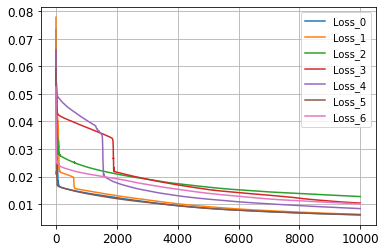

In [ ]:
predict_timelvl2(models_generator[4], n, 4)

ganmodels/E3000/model_vE3000_125b_wgan_292_second_17000.h5
------------------------

286s
MSE Loss:  0.006555745
MAE Loss:  0.092247106


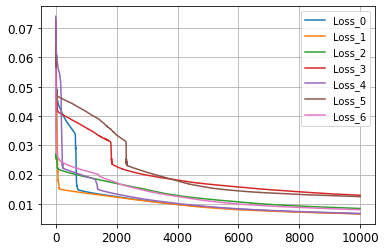

In [ ]:
predict_timelvl2(models_generator[5], n, 5)

ganmodels/E3000/model_vE3000_125b_wgan_292_second_18000.h5
------------------------

286s
MSE Loss:  0.0056677125
MAE Loss:  0.085646056


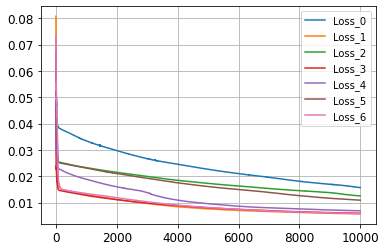

In [ ]:
predict_timelvl2(models_generator[6], n, 6)

**Generated Data**

In [ ]:
def gen_pred_timelvl2(generator, opt_lat_val, model_idx):
  print(model_dir_arr[model_idx])
  print('--------------------------')
  print()
  X_gen = generator.predict(np.asarray(opt_lat_val)).reshape(ntimes,codings_size)
  models_pred2[model_idx] = X_gen
  X_gen = invert_data3(X_gen)
  X_gen = X_gen.reshape(ntimes, nx*nx)
  plot_vortex(X_gen.reshape(ntimes, nx, nx), times, 7, c_bar=False, skips=5)

ganmodels/E3000/model_vE3000_125b_wganHalfLR_292_second_33500.h5
--------------------------



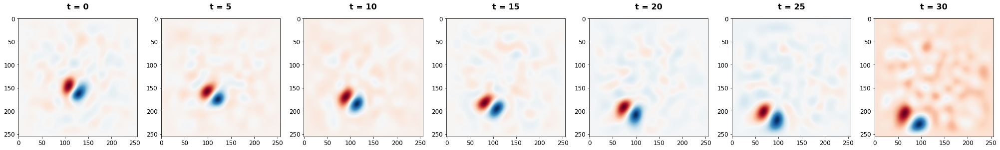

In [ ]:
gen_pred_timelvl2(models_generator[1], models_opt_latent2[1], 1)

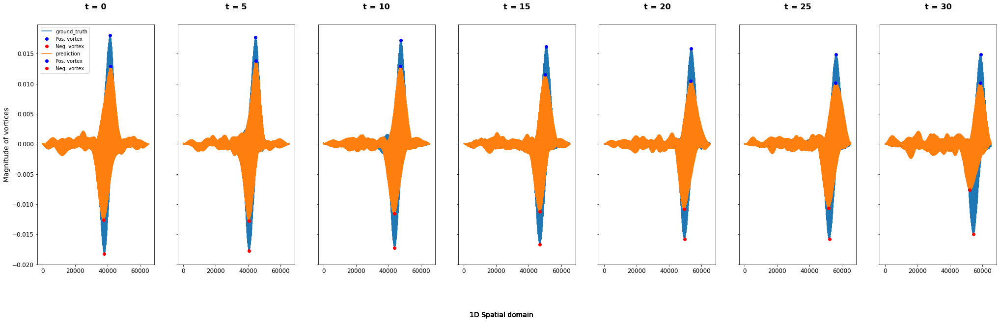

In [ ]:
X_gen = invert_data3(models_pred2[1])
X_gen = X_gen.reshape(ntimes, nx*nx)
plot_dict = { 'ground_truth': X_real2, 'prediction': X_gen}
plot_linevortex(plot_dict, times, len(times), skips=5)

ganmodels/E3000/model_vE3000_64b_wgan_01_292_4500.h5
--------------------------



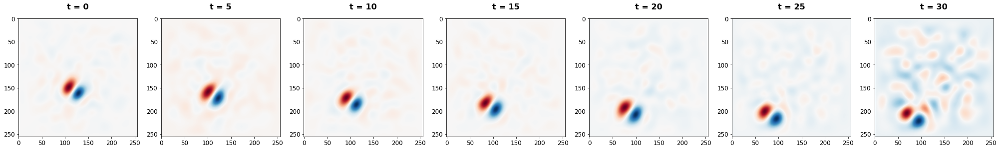

In [ ]:
gen_pred_timelvl2(models_generator[2], models_opt_latent2[2], 2)

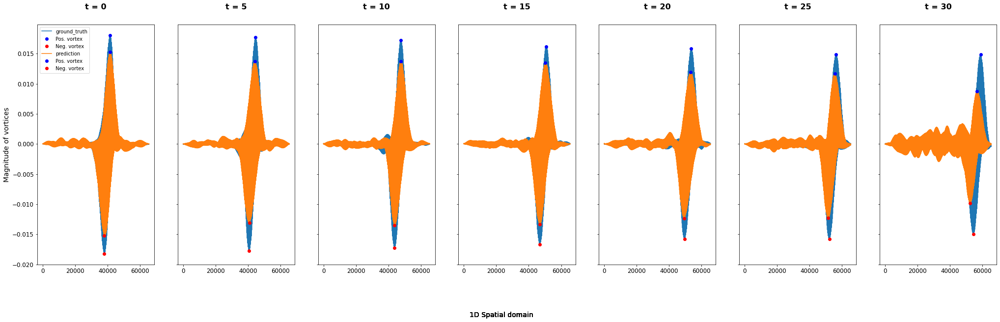

In [ ]:
X_gen = invert_data3(models_pred2[2])
X_gen = X_gen.reshape(ntimes, nx*nx)
plot_dict = { 'ground_truth': X_real2, 'prediction': X_gen}
plot_linevortex(plot_dict, times, len(times), skips=5)

ganmodels/E3000/model_vE3000_64b_wgan_01_292_7500.h5
--------------------------



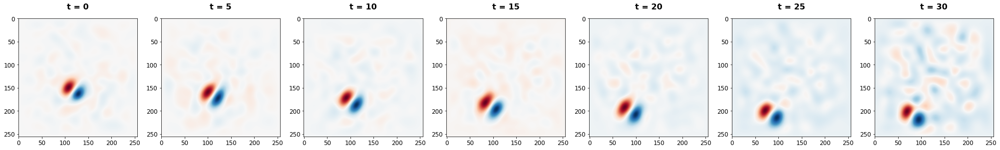

In [ ]:
gen_pred_timelvl2(models_generator[3], models_opt_latent2[3], 3)

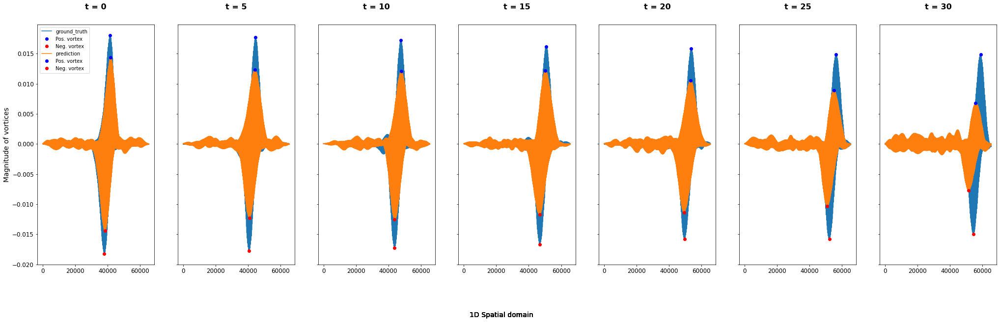

In [ ]:
X_gen = invert_data3(models_pred2[3])
X_gen = X_gen.reshape(ntimes, nx*nx)
plot_dict = { 'ground_truth': X_real2, 'prediction': X_gen}
plot_linevortex(plot_dict, times, len(times), skips=5)

ganmodels/E3000/model_vE3000_125b_wgan_292_second_11000.h5
--------------------------



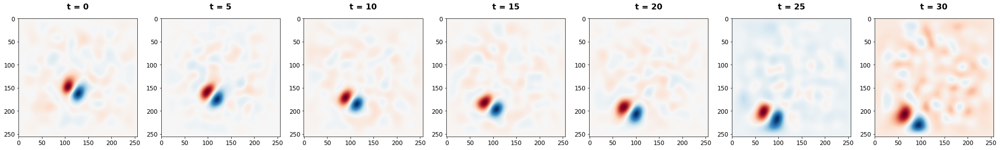

In [ ]:
gen_pred_timelvl2(models_generator[4], models_opt_latent2[4], 4)

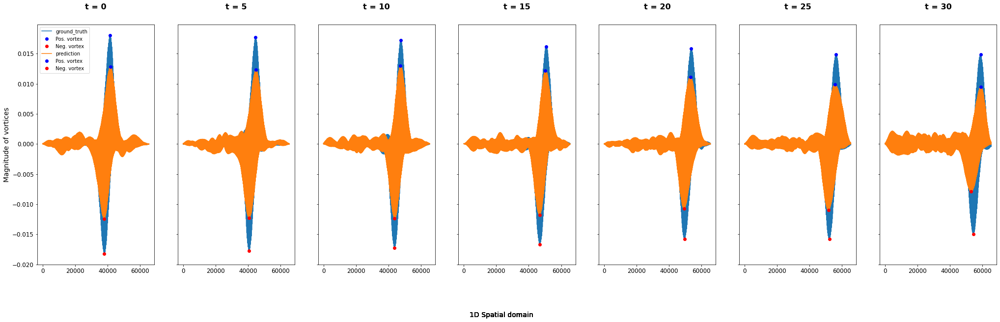

In [ ]:
X_gen = invert_data3(models_pred2[4])
X_gen = X_gen.reshape(ntimes, nx*nx)
plot_dict = { 'ground_truth': X_real2, 'prediction': X_gen}
plot_linevortex(plot_dict, times, len(times), skips=5)

ganmodels/E3000/model_vE3000_125b_wgan_292_second_17000.h5
--------------------------



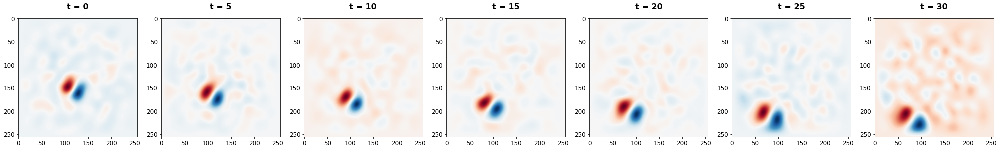

In [ ]:
gen_pred_timelvl2(models_generator[5], models_opt_latent2[5], 5)

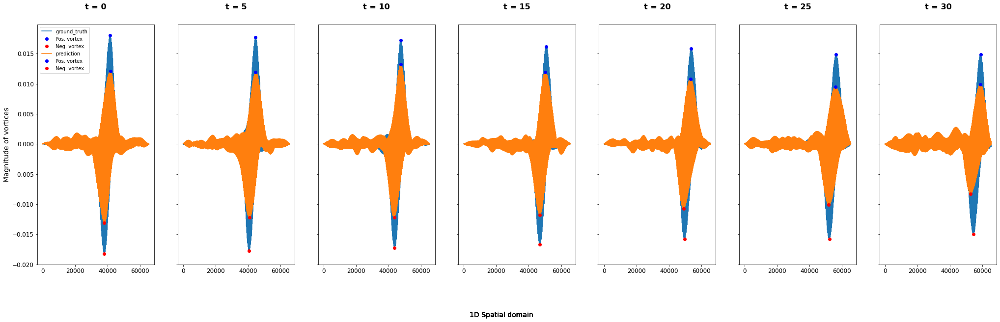

In [ ]:
X_gen = invert_data3(models_pred2[5])
X_gen = X_gen.reshape(ntimes, nx*nx)
plot_dict = { 'ground_truth': X_real2, 'prediction': X_gen}
plot_linevortex(plot_dict, times, len(times), skips=5)

ganmodels/E3000/model_vE3000_125b_wgan_292_second_18000.h5
--------------------------



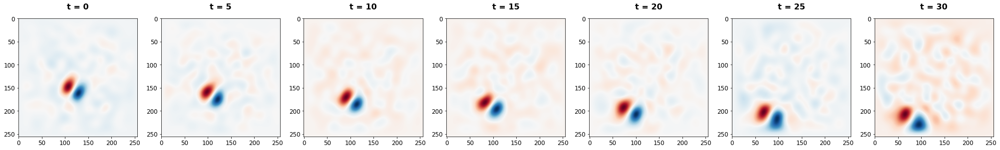

In [ ]:
gen_pred_timelvl2(models_generator[6], models_opt_latent2[6], 6)

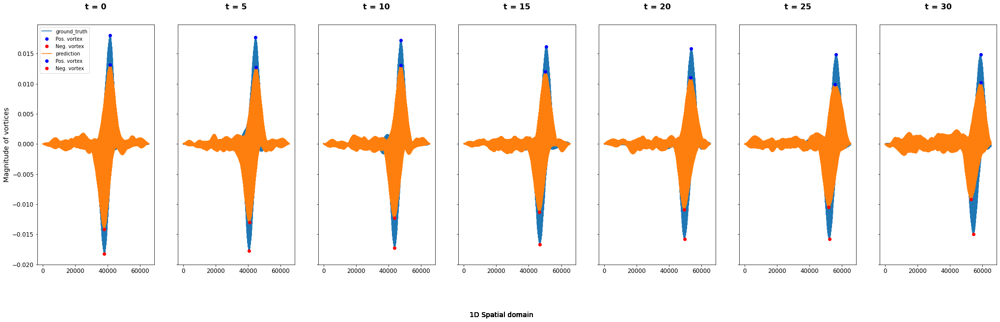

In [ ]:
X_gen = invert_data3(models_pred2[6])
X_gen = X_gen.reshape(ntimes, nx*nx)
plot_dict = { 'ground_truth': X_real2, 'prediction': X_gen}
plot_linevortex(plot_dict, times, len(times), skips=5)

In [ ]:
print(np.max(X_gen[-1]))

0.013330745368535289


### Predict Multiple Points

#### Sample 1

In [ ]:
models_pred_mse_err3 = {}
models_pred_mae_err3 = {}
models_pred_time3 = {}
models_opt_latent3 = {}
model_pred_multiple = {}
model_loss_multiple = {}

In [ ]:
np.random.seed(0)
tf.random.set_seed(0)
latent_size=3000
codings_size = 292
n = 4560
opt_epochs = 10000
weight = tf.constant(pca3.singular_values_, dtype=tf.float32)




codings_size = num_of_coeff

optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)
latent_values = tf.Variable(tf.random.normal([len(real_coding), latent_size]))

def predict_timelvl3(generator, n, model_idx):
    list_latent_values = []
    list_loss = []
    start = time.time()
    for i in range(7):

        latent_values = tf.Variable(tf.random.normal([len(real_coding), latent_size]))
        # instantiating prediction optimizer
        pred_optim = Pred_optimizer(generator, real_coding, weight, latent_values, mse_loss, optimizer)
        opt_latent_values, loss = pred_optim(opt_epochs=opt_epochs, num_call=i)
        list_latent_values.append(opt_latent_values)
        list_loss.append(loss)

    opt_latent_values = list_latent_values[np.argmin(list_loss)]
    # print('Initial point losses: ', end=' - ')
    # print(list_loss)
    time_to_pred = time.time()-start
    print('{:.0f}s'.format( time_to_pred))
  
    l_mse = mse_loss(generator(opt_latent_values)[:,:(ntimes - 1),:,:], real_coding).numpy()
    l_mae = mae_loss(generator(opt_latent_values)[:,:(ntimes - 1),:,:], real_coding).numpy()
    print('MSE Loss: ', l_mse)
    print('MAE Loss: ', l_mae)

    models_pred_mse_err3[model_idx] = l_mse
    models_pred_mae_err3[model_idx] = l_mae
    models_pred_time3[model_idx] = time_to_pred
    models_opt_latent3[model_idx] = opt_latent_values



In [ ]:

def predict_multi_timelvl (generator, n, model_idx, pred_for):
    # predict first time level  using existing method.
    print(model_dir_arr[model_idx])
    print('--------------------------')
    print()
    real_coding = X_train_concat_flatten3[n].reshape(1,-1)
    real_coding = tf.constant(real_coding[:,:codings_size*(ntimes - 1)])
    real_coding = tf.cast(real_coding, dtype=tf.float32)
    predict_timelvl3(generator, n, model_idx)

    # Generate from the optimized latent value
    latent_values = models_opt_latent3[model_idx]
    X_predict = list(generator(latent_values).numpy().reshape(-1,codings_size))
    gen_predict = X_predict[-1]

    real_coding = np.concatenate((real_coding, gen_predict.reshape(1,-1)), axis=1)[:,codings_size:]
    real_coding = tf.constant(real_coding)
    real_coding = tf.cast(real_coding, dtype=tf.float32)
    plt.show()

    # continue prediction with opt latent values. create new instance with the optimized latent
    pred_losses = []
    pred_optimMult = Pred_optimizer(generator, real_coding, weight, latent_values, mse_loss, optimizer)
    for i in range(pred_for): 
        start = time.time()
        latent_values, loss = pred_optimMult(opt_epochs=opt_epochs, num_call=i)
        print('Loss iteration '+str(i+1)+': '+str(loss), end=' - ')
        pred_losses.append(loss)    
        gen_predict = generator(latent_values)[:,(ntimes - 1):,:,:].numpy().flatten()
        X_predict.append(gen_predict)
        
        real_coding = np.concatenate((real_coding, gen_predict.reshape(1,-1)), axis=1)[:,codings_size:]
        real_coding = tf.constant(real_coding)
        real_coding = tf.cast(real_coding, dtype=tf.float32)
        print ('{:.0f}s'.format( time.time()-start))
        
    X_predict = np.array(X_predict)
    model_pred_multiple[model_idx] = np.array(X_predict)
    model_loss_multiple[model_idx] = pred_losses

ganmodels/E3000/model_vE3000_125b_wganHalfLR_292_second_39500.h5
--------------------------

286s
MSE Loss:  0.0045902617
MAE Loss:  0.07337612


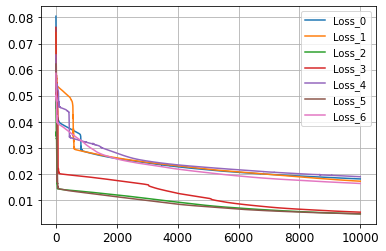

Loss iteration 1: 0.0025173856 - 41s
Loss iteration 2: 0.0017898687 - 40s
Loss iteration 3: 0.0013976437 - 40s


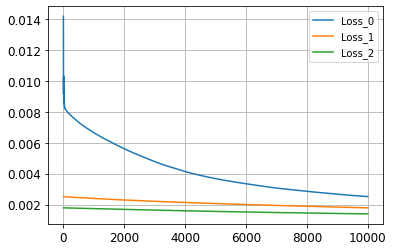

In [ ]:
 predict_multi_timelvl (models_generator[0], n, 0, 3)

ganmodels/E3000/model_vE3000_125b_wganHalfLR_292_second_33500.h5
--------------------------

288s
MSE Loss:  0.004251044
MAE Loss:  0.07322177


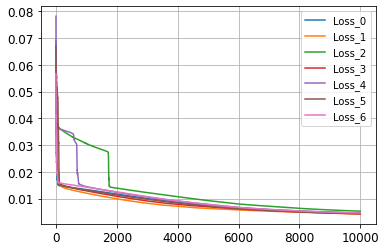

Loss iteration 1: 0.0027212233 - 41s
Loss iteration 2: 0.001892291 - 41s
Loss iteration 3: 0.0014557326 - 41s


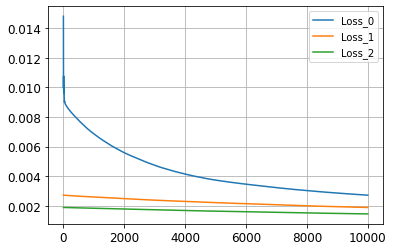

In [ ]:
 predict_multi_timelvl (models_generator[1], n, 1, 3)

ganmodels/E3000/model_vE3000_64b_wgan_01_292_4500.h5
--------------------------

267s
MSE Loss:  0.0022893837
MAE Loss:  0.047820043


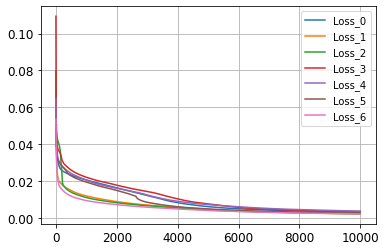

Loss iteration 1: 0.0012572961 - 38s
Loss iteration 2: 0.000839909 - 37s
Loss iteration 3: 0.0006425138 - 37s


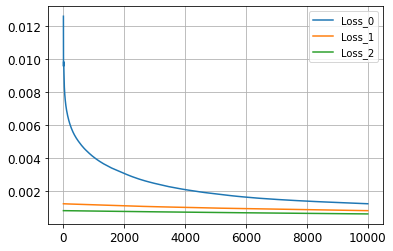

In [ ]:
 predict_multi_timelvl (models_generator[2], n, 2, 3)

ganmodels/E3000/model_vE3000_64b_wgan_01_292_7500.h5
--------------------------

267s
MSE Loss:  0.00338893
MAE Loss:  0.060947325


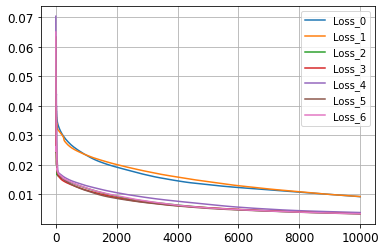

Loss iteration 1: 0.0019164843 - 38s
Loss iteration 2: 0.0013073202 - 37s
Loss iteration 3: 0.0010006217 - 38s


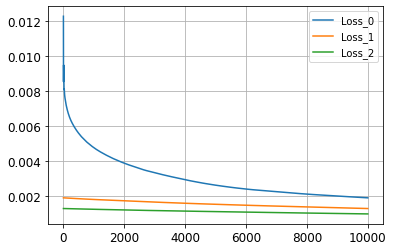

In [ ]:
 predict_multi_timelvl (models_generator[3], n, 3, 3)

ganmodels/E3000/model_vE3000_125b_wgan_292_second_11000.h5
--------------------------

286s
MSE Loss:  0.004362806
MAE Loss:  0.07373511


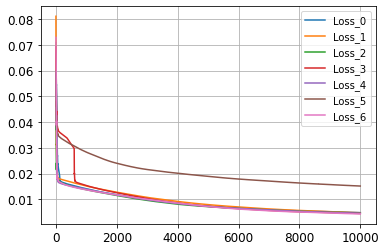

Loss iteration 1: 0.002417316 - 41s
Loss iteration 2: 0.0017883856 - 40s
Loss iteration 3: 0.0014603147 - 40s


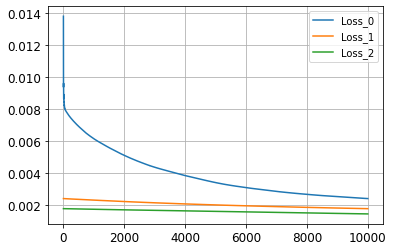

In [ ]:
 predict_multi_timelvl (models_generator[4], n, 4, 3)

ganmodels/E3000/model_vE3000_125b_wgan_292_second_17000.h5
--------------------------

286s
MSE Loss:  0.004426498
MAE Loss:  0.07521378


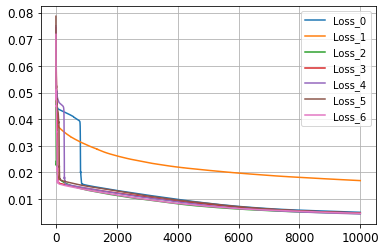

Loss iteration 1: 0.0025822818 - 41s
Loss iteration 2: 0.0019074796 - 40s
Loss iteration 3: 0.0015484573 - 40s


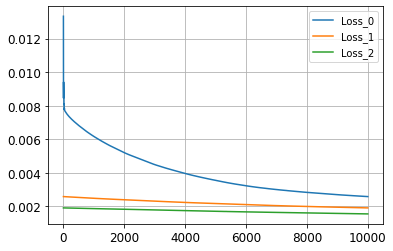

In [ ]:
 predict_multi_timelvl (models_generator[5], n, 5, 3)

ganmodels/E3000/model_vE3000_125b_wgan_292_second_18000.h5
--------------------------

286s
MSE Loss:  0.004031336
MAE Loss:  0.07142349


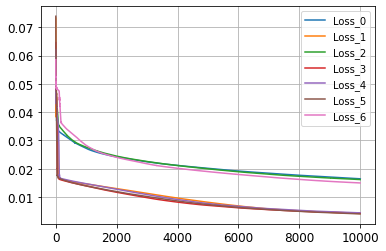

Loss iteration 1: 0.0022345542 - 41s
Loss iteration 2: 0.0015328961 - 40s
Loss iteration 3: 0.0012143792 - 40s


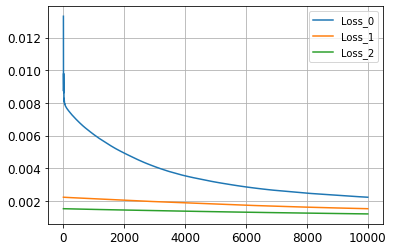

In [ ]:
 predict_multi_timelvl (models_generator[6], n, 6, 3)

**Original Snapshots**

(10, 256, 256)


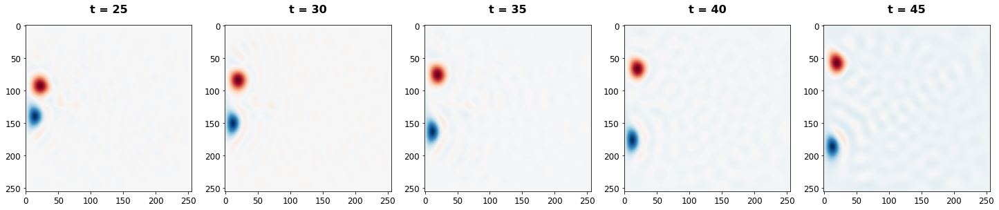

In [ ]:
orig_start = int(n*2.5) + 4 # spacing in concatenation is 50/20. Mismatch only for this case
orig_end = orig_start+ 50
X_original = X_train1d_pca_scaled3[orig_start:orig_end:5]
X_real_all = invert_data3(X_original)
X_real_all = X_real_all.reshape(-1, nx,nx)
print(X_real_all.shape)
plot_vortex(X_real_all, times[-5:],5, 1, skips=5, c_bar=False)

**Generated snapshots**

In [ ]:
def gen_pred_timelvl3(generator, opt_lat_val, model_idx):
  print(model_dir_arr[model_idx])
  print('--------------------------')
  print()
  X_gen = generator.predict(np.asarray(opt_lat_val)).reshape(ntimes,codings_size)
  models_pred2[model_idx] = X_gen
  X_gen = invert_data3(X_gen)
  X_gen = X_gen.reshape(ntimes, nx*nx)
  plot_vortex(X_gen.reshape(ntimes, nx, nx), times, 7, c_bar=False, skips=5)

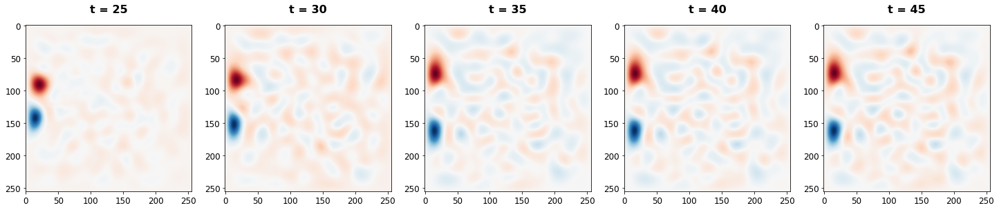

In [ ]:
times = [i for i in range(10)]
X_gen_mult = invert_data3(model_pred_multiple[0]).reshape(-1, nx, ny)
plot_vortex(X_gen_mult, times[-5:], 5, 1, skips=5, c_bar=False, )

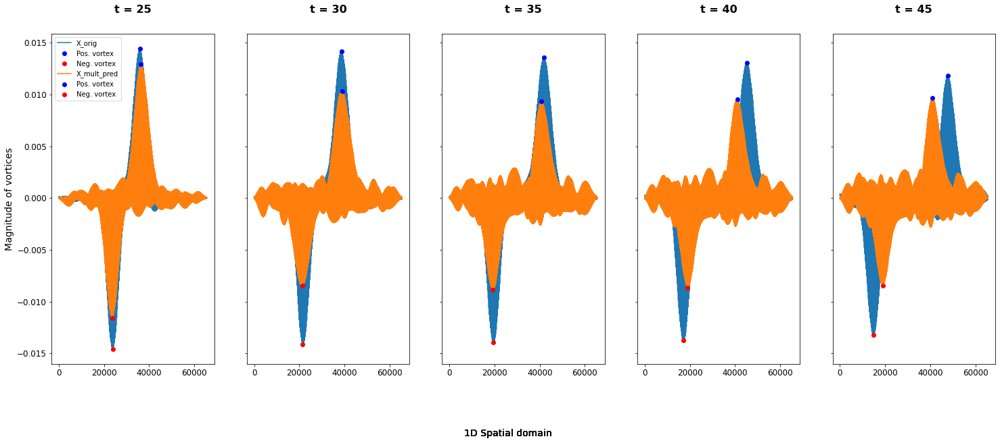

In [ ]:
data_dict = {'X_orig':X_real_all, 'X_mult_pred':X_gen_mult}
plot_linevortex(data_dict, times[-5:], 5, 1, skips=5)

ganmodels/E3000/model_vE3000_125b_wganHalfLR_292_second_33500.h5
 --------------------------


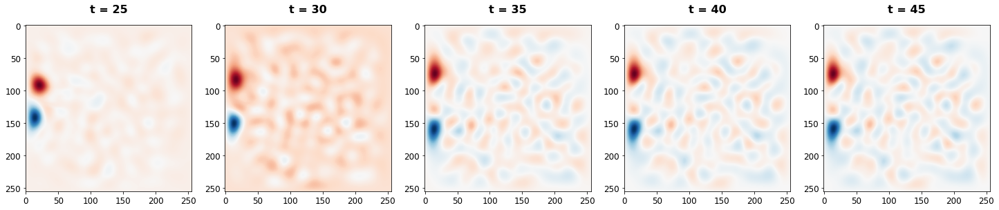

In [ ]:
print (model_dir_arr[1])
print(' --------------------------')
X_gen_mult = invert_data3(model_pred_multiple[1]).reshape(-1, nx, ny)
plot_vortex(X_gen_mult, times[-5:], 5, 1, skips=5, c_bar=False, )

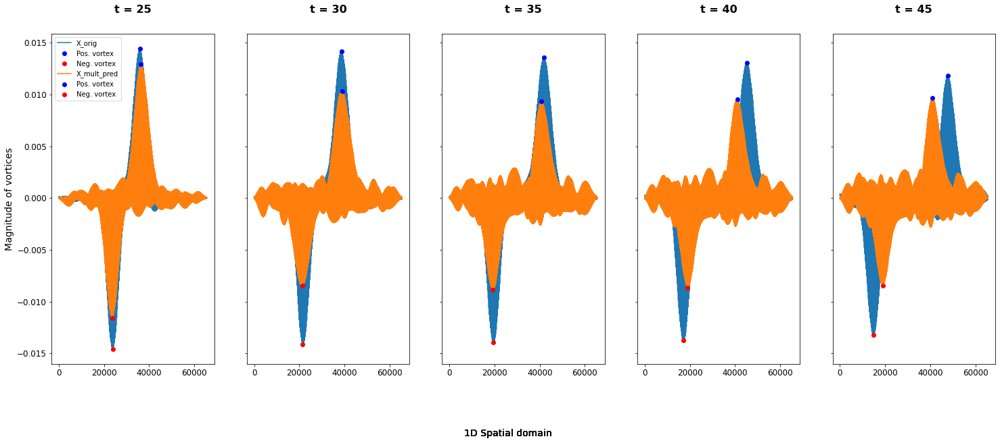

In [ ]:
data_dict = {'X_orig':X_real_all, 'X_mult_pred':X_gen_mult}
plot_linevortex(data_dict, times[-5:], 5, 1, skips=5)

ganmodels/E3000/model_vE3000_64b_wgan_01_292_4500.h5
 --------------------------


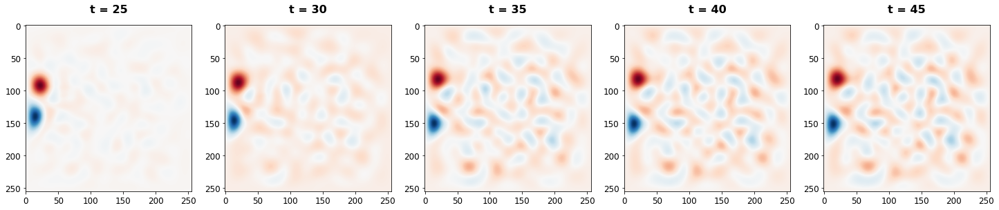

In [ ]:
print (model_dir_arr[2])
print(' --------------------------')
X_gen_mult = invert_data3(model_pred_multiple[2]).reshape(-1, nx, ny)
plot_vortex(X_gen_mult, times[-5:], 5, 1, skips=5, c_bar=False, )

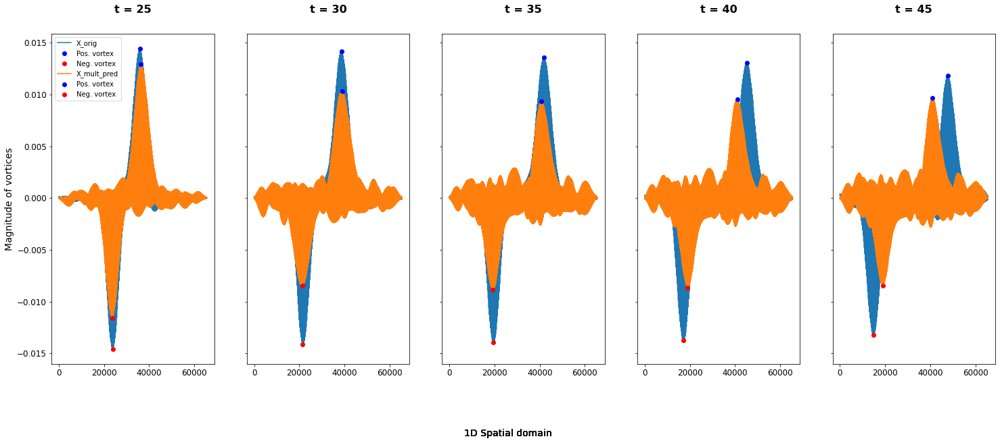

In [ ]:
data_dict = {'X_orig':X_real_all, 'X_mult_pred':X_gen_mult}
plot_linevortex(data_dict, times[-5:], 5, 1, skips=5)

ganmodels/E3000/model_vE3000_64b_wgan_01_292_7500.h5
 --------------------------


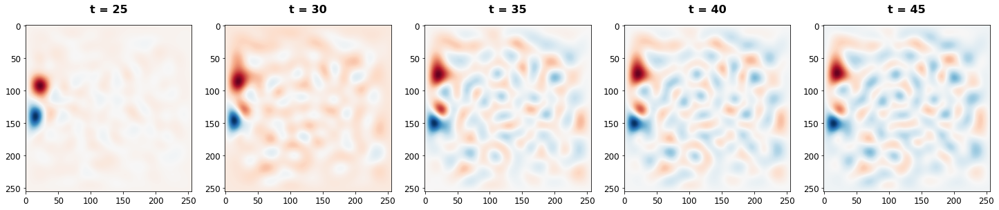

In [ ]:
print (model_dir_arr[3])
print(' --------------------------')
X_gen_mult = invert_data3(model_pred_multiple[3]).reshape(-1, nx, ny)
plot_vortex(X_gen_mult, times[-5:], 5, 1, skips=5, c_bar=False)

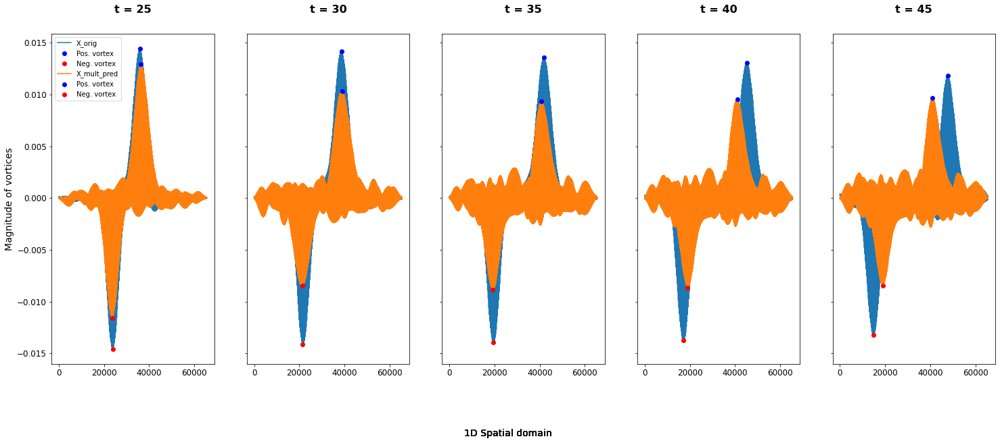

In [ ]:
data_dict = {'X_orig':X_real_all, 'X_mult_pred':X_gen_mult}
plot_linevortex(data_dict, times[-5:], 5, 1, skips=5)

ganmodels/E3000/model_vE3000_125b_wgan_292_second_11000.h5
 --------------------------


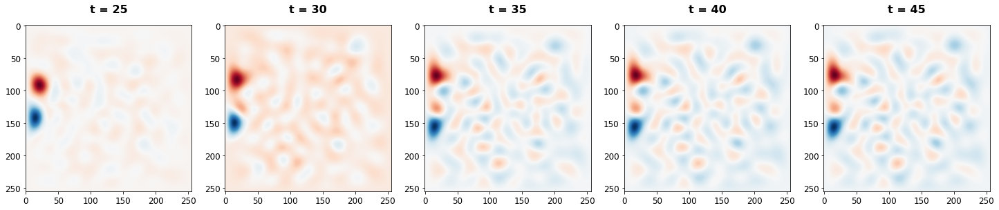

In [ ]:
print (model_dir_arr[4])
print(' --------------------------')
X_gen_mult = invert_data3(model_pred_multiple[4]).reshape(-1, nx, ny)
plot_vortex(X_gen_mult, times[-5:], 5, 1, skips=5, c_bar=False, )

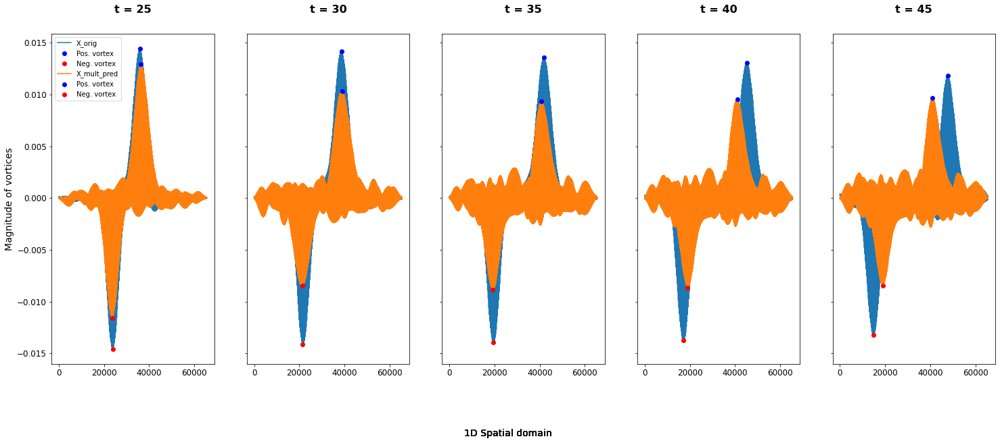

In [ ]:
data_dict = {'X_orig':X_real_all, 'X_mult_pred':X_gen_mult}
plot_linevortex(data_dict, times[-5:], 5, 1, skips=5)

ganmodels/E3000/model_vE3000_125b_wgan_292_second_17000.h5
 --------------------------


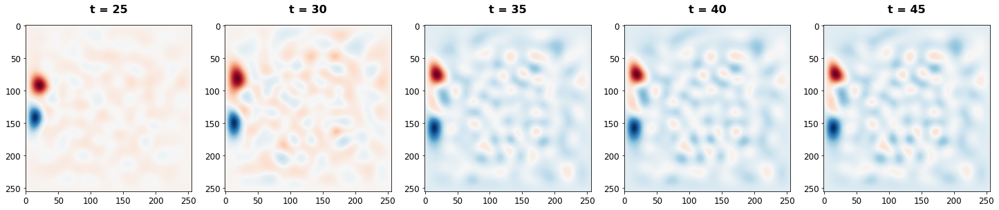

In [ ]:
print (model_dir_arr[5])
print(' --------------------------')
X_gen_mult = invert_data3(model_pred_multiple[5]).reshape(-1, nx, ny)
plot_vortex(X_gen_mult, times[-5:], 5, 1, skips=5, c_bar=False, )

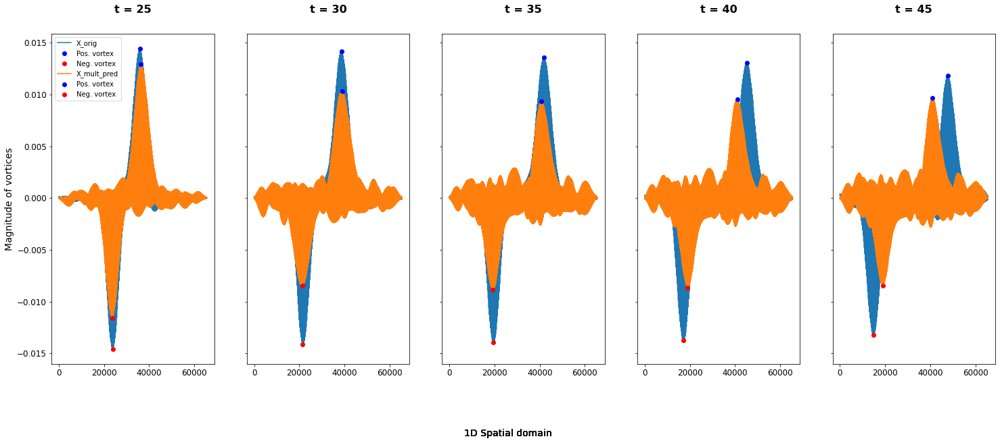

In [ ]:
data_dict = {'X_orig':X_real_all, 'X_mult_pred':X_gen_mult}
plot_linevortex(data_dict, times[-5:], 5, 1, skips=5)